In [26]:
import os
import time
from tqdm import tqdm
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt

IMAGE_SHAPE = (128, 128, 3)
NOISE_DIM = 100
BATCH_SIZE = 128
DATA_PATH = '/Users/nakuldagar/100_days_of_code/Genai/img_align_celeba'

def preprocess_image(file_path):
    img_raw = tf.io.read_file(file_path)
    img = tf.image.decode_jpeg(img_raw, channels=3)
    img = tf.image.resize(img, (IMAGE_SHAPE[0], IMAGE_SHAPE[1]))
    img = (img / 127.5) - 1.0  # Normalize to [-1, 1]
    return img

def load_celeba_images(path):
    all_files = [os.path.join(path, f) for f in os.listdir(path)[:10000] if f.endswith('.jpg')]
    dataset = tf.data.Dataset.from_tensor_slices(all_files)
    dataset = dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)

    images_list = []
    for batch in tqdm(dataset.batch(1024).prefetch(tf.data.AUTOTUNE)):
        images_list.append(batch)

    return tf.concat(images_list, axis=0)

images = load_celeba_images(DATA_PATH)
dataset = tf.data.Dataset.from_tensor_slices(images) \
                         .shuffle(buffer_size=50000) \
                         .batch(BATCH_SIZE) \
                         .prefetch(tf.data.AUTOTUNE)

2025-07-27 22:38:43.181465: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
100%|███████████████████████████████████████████| 10/10 [00:00<00:00, 10.15it/s]


In [27]:
import tensorflow as tf
from tensorflow.keras import layers

def build_generator(NOISE_DIM=NOISE_DIM):
    model = tf.keras.Sequential([
        # 1) Start with a dense layer that reshapes to 8x8 with 512 channels
        layers.Dense(8*8*512, use_bias=False, input_shape=(NOISE_DIM,)),
        layers.Reshape((8, 8, 512)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 2) Upsample to 16x16
        layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 3) Upsample to 32x32
        layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 4) Upsample to 64x64
        layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 5) Upsample to 128x128
        layers.Conv2DTranspose(32, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 6) Final layer → 128x128x3, use tanh for output in [-1,1]
        layers.Conv2DTranspose(3, (4,4), strides=(1,1), padding='same', use_bias=False, activation='tanh')
    ], name="Generator")

    return model

def build_discriminator():
    model = tf.keras.Sequential([
        # 1) Downsample from 128x128 to 64x64
        layers.Conv2D(64, (4,4), strides=(2,2), padding='same', 
                      input_shape=(128,128,3)),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 2) Downsample to 32x32
        layers.Conv2D(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 3) Downsample to 16x16
        layers.Conv2D(256, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 4) Downsample to 8x8
        layers.Conv2D(512, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 5) Flatten to a single logit
        layers.Flatten(),
        layers.Dense(1)
    ], name="Discriminator")

    return model

In [28]:
generator = build_generator()
discriminator = build_discriminator()

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

In [29]:
def train_step(real_images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        # Ensure shapes match
        assert generated_images.shape[1:] == IMAGE_SHAPE, "Generated image shape mismatch!"
        assert real_images.shape[1:] == IMAGE_SHAPE, "Real image shape mismatch!"

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        g_loss = generator_loss(fake_output)
        d_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return g_loss, d_loss


In [30]:
def generate_and_show_images(noise):
    # Generate images
    preds = generator(noise, training=False)
    preds = (preds + 1) / 2.0  # Shift from [-1,1] to [0,1]
    
    # Plot
    fig = plt.figure(figsize=(4,4))
    for i in range(preds.shape[0]):
        plt.subplot(4,4,i+1)
        plt.imshow(preds[i])
        plt.axis('off')
    plt.show()

In [6]:
def save_weights():
    generator.save_weights('generator1.weights.h5')
    discriminator.save_weights('discriminator1.weights.h5')

In [25]:
def train(dataset, epochs):
    fixed_noise = tf.random.normal([16, NOISE_DIM])
    total_start_time = time.time()

    for epoch in range(epochs):
        epoch_start_time = time.time()
        
        g_losses = []
        d_losses = []

        # 🌟 Add tqdm progress bar for each batch
        for image_batch in tqdm(dataset, desc=f"Epoch {epoch+1}/{epochs}"):
            g_loss, d_loss = train_step(image_batch)
            g_losses.append(g_loss)
            d_losses.append(d_loss)

        avg_g_loss = tf.reduce_mean(g_losses)
        avg_d_loss = tf.reduce_mean(d_losses)

        epoch_end_time = time.time()
        epoch_duration = epoch_end_time - epoch_start_time

        print(f"Generator Loss: {avg_g_loss:.4f} | Discriminator Loss: {avg_d_loss:.4f} | Time: {epoch_duration:.2f} sec")

        # Generate and show images after every epoch
        generate_and_show_images(fixed_noise)
        save_weights()

    total_end_time = time.time()
    total_duration = total_end_time - total_start_time
    print(f"\n🎉 Total Training Time: {total_duration:.2f} sec")

2025-07-27 22:10:50.561113: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 1/5: 100%|████████████████████████████████| 79/79 [03:07<00:00,  2.37s/it]


Generator Loss: 5.0685 | Discriminator Loss: 0.1677 | Time: 187.56 sec


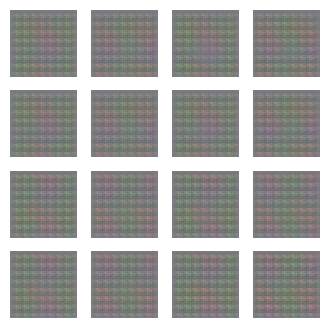

2025-07-27 22:14:20.404799: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 2/5: 100%|████████████████████████████████| 79/79 [03:29<00:00,  2.65s/it]

Generator Loss: 11.9750 | Discriminator Loss: 0.3960 | Time: 209.42 sec


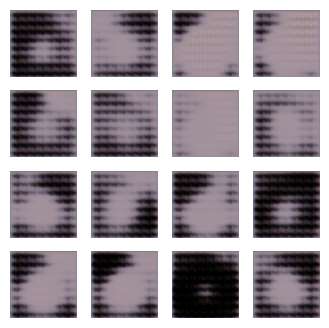

2025-07-27 22:18:37.559682: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 3/5: 100%|████████████████████████████████| 79/79 [04:16<00:00,  3.25s/it]

Generator Loss: 2.8092 | Discriminator Loss: 0.5005 | Time: 256.91 sec


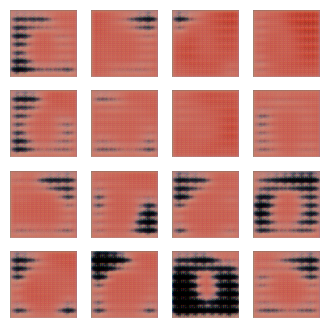

2025-07-27 22:23:19.464691: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 4/5: 100%|████████████████████████████████| 79/79 [04:41<00:00,  3.57s/it]


Generator Loss: 3.5980 | Discriminator Loss: 0.3350 | Time: 281.68 sec


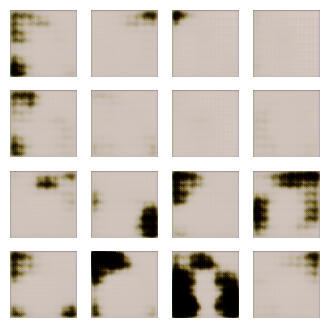

2025-07-27 22:27:52.543847: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 5/5: 100%|████████████████████████████████| 79/79 [04:32<00:00,  3.45s/it]

Generator Loss: 3.5759 | Discriminator Loss: 0.3335 | Time: 272.51 sec


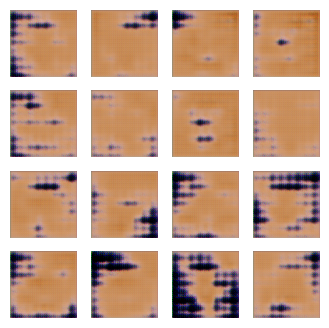


🎉 Total Training Time: 1209.69 sec


In [11]:
train(dataset, 5)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step


2025-07-27 22:07:27.992778: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:117] Plugin optimizer for device_type GPU is enabled.


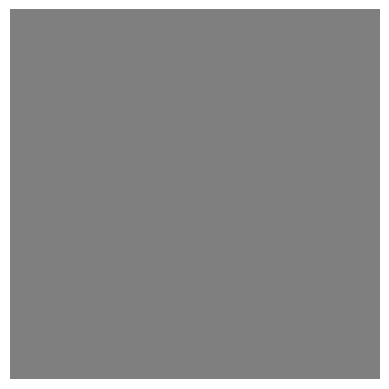

In [9]:
noise = np.random.normal(0, 1, (1, 100))  # 1 is the batch size, 100 is the latent space dimension

# Generate the fake image
generated_image = generator.predict(noise)
generated_image = (generated_image + 1) / 2.0  

# Plot the image
plt.imshow(generated_image[0])
plt.axis('off')
plt.show()

In [13]:
def plot_generated_images(epoch, square=5):
    plt.figure(figsize=(10, 10))
    for i in range(square * square):
        noise = tf.random.uniform([1, NOISE_DIM], minval=-1, maxval=1)
        img = generator(noise, training=False)
        plt.subplot(square, square, i + 1)
        plt.imshow((img[0] + 1) / 2)
        plt.axis('off')
    plt.show()

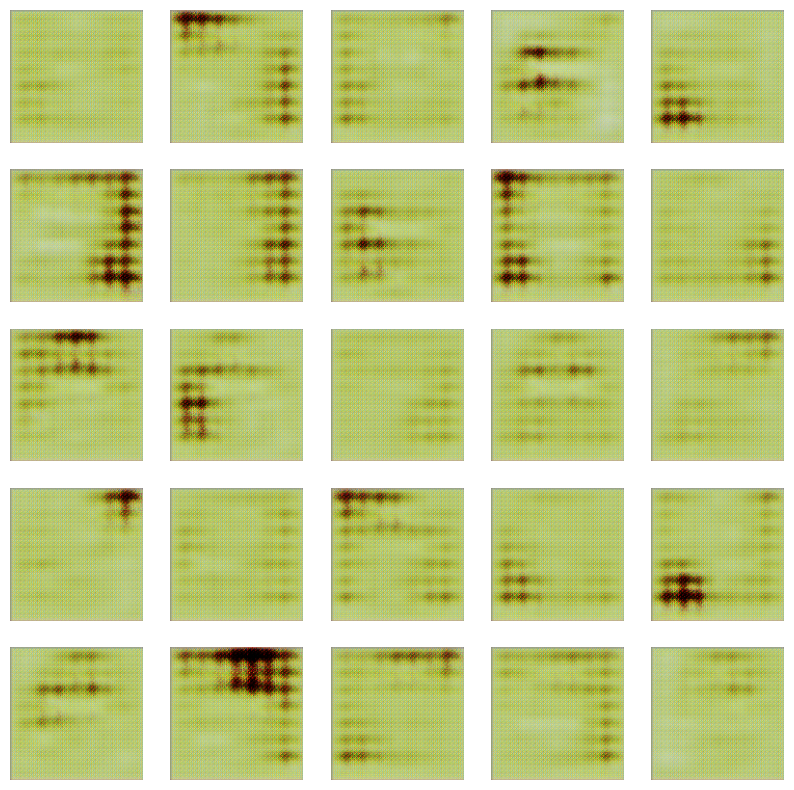

In [37]:
plot_generated_images(5)

2025-03-16 06:47:55.865207: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 1/100: 100%|██████████████████████████████| 79/79 [03:30<00:00,  2.66s/it]

Generator Loss: 3.7991 | Discriminator Loss: 0.4602 | Time: 210.29 sec


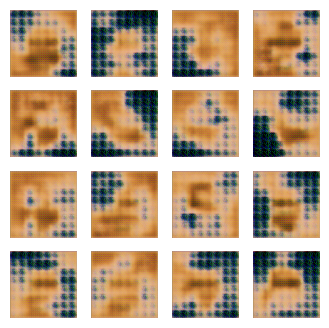

2025-03-16 06:51:59.721863: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 2/100: 100%|██████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 4.7646 | Discriminator Loss: 0.2391 | Time: 243.63 sec


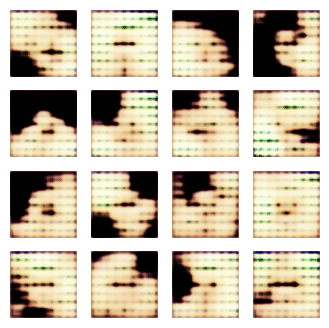

2025-03-16 06:55:56.845349: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 3/100: 100%|██████████████████████████████| 79/79 [03:56<00:00,  3.00s/it]

Generator Loss: 3.6040 | Discriminator Loss: 0.5906 | Time: 236.89 sec


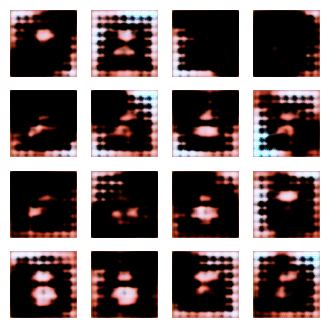

2025-03-16 06:59:52.187068: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 4/100: 100%|██████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 2.8324 | Discriminator Loss: 0.4449 | Time: 235.13 sec


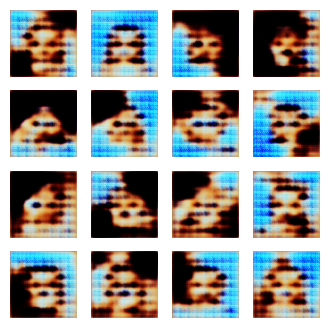

2025-03-16 07:03:53.457330: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 5/100: 100%|██████████████████████████████| 79/79 [04:00<00:00,  3.05s/it]

Generator Loss: 4.0157 | Discriminator Loss: 0.3921 | Time: 241.01 sec


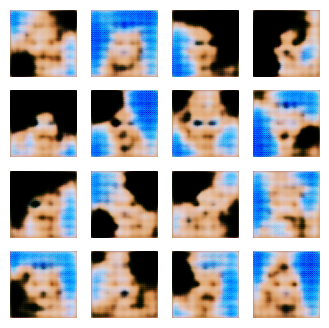

2025-03-16 07:07:52.208458: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 6/100: 100%|██████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 2.6197 | Discriminator Loss: 0.3967 | Time: 238.53 sec


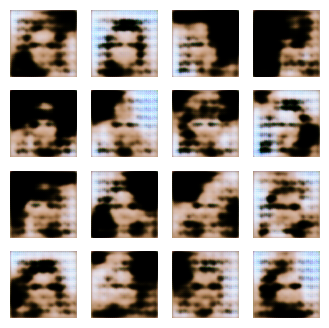

2025-03-16 07:11:52.940840: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 7/100: 100%|██████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 2.9344 | Discriminator Loss: 0.5349 | Time: 240.51 sec


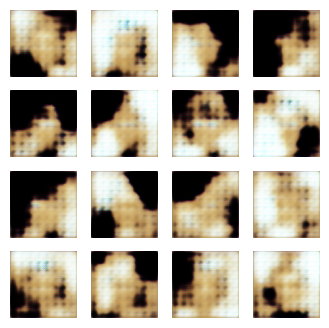

2025-03-16 07:16:04.462057: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 8/100: 100%|██████████████████████████████| 79/79 [04:11<00:00,  3.18s/it]

Generator Loss: 3.2055 | Discriminator Loss: 0.5268 | Time: 251.30 sec


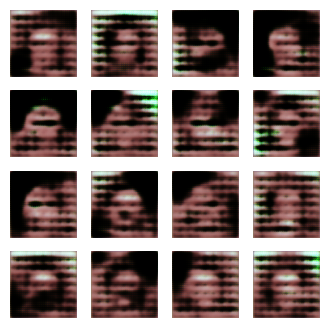

2025-03-16 07:20:08.346992: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 9/100: 100%|██████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 3.4433 | Discriminator Loss: 0.7813 | Time: 243.65 sec


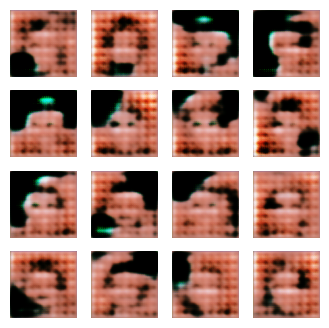

2025-03-16 07:24:14.787522: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 10/100: 100%|█████████████████████████████| 79/79 [04:06<00:00,  3.12s/it]

Generator Loss: 2.2783 | Discriminator Loss: 0.4595 | Time: 246.22 sec


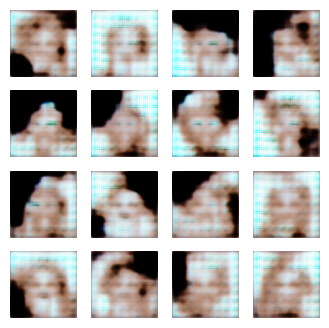

2025-03-16 07:28:19.518734: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 11/100: 100%|█████████████████████████████| 79/79 [04:04<00:00,  3.09s/it]


Generator Loss: 2.3265 | Discriminator Loss: 0.4427 | Time: 244.52 sec


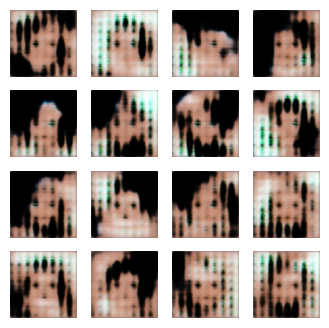

2025-03-16 07:32:26.218312: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 12/100: 100%|█████████████████████████████| 79/79 [04:06<00:00,  3.12s/it]

Generator Loss: 2.3451 | Discriminator Loss: 0.5301 | Time: 246.22 sec


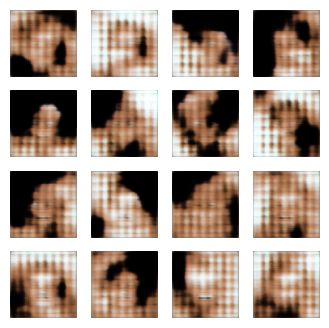

2025-03-16 07:36:31.110484: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 13/100: 100%|█████████████████████████████| 79/79 [04:04<00:00,  3.10s/it]

Generator Loss: 2.0472 | Discriminator Loss: 0.5848 | Time: 244.65 sec


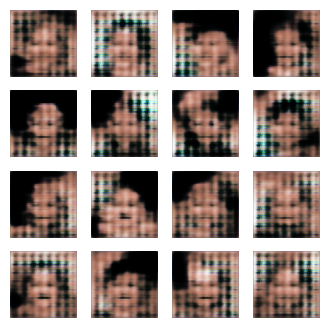

2025-03-16 07:40:29.001016: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 14/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 2.7238 | Discriminator Loss: 0.4702 | Time: 237.66 sec


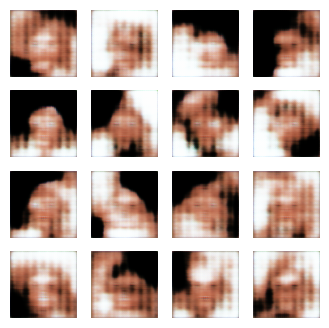

2025-03-16 07:44:24.932953: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 15/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 2.5259 | Discriminator Loss: 0.7238 | Time: 235.71 sec


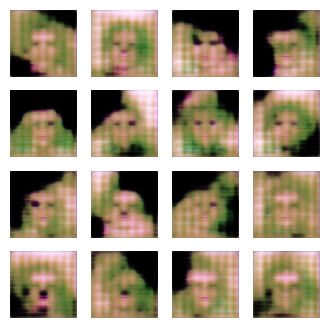

2025-03-16 07:48:47.856559: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 16/100: 100%|█████████████████████████████| 79/79 [04:22<00:00,  3.33s/it]

Generator Loss: 3.0216 | Discriminator Loss: 0.5835 | Time: 262.72 sec


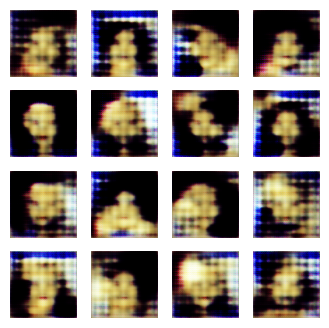

2025-03-16 07:52:54.396419: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 17/100: 100%|█████████████████████████████| 79/79 [04:06<00:00,  3.12s/it]

Generator Loss: 3.7017 | Discriminator Loss: 0.3960 | Time: 246.29 sec


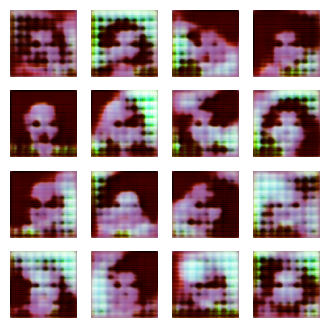

2025-03-16 07:56:53.787743: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 18/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 11.8889 | Discriminator Loss: 0.3777 | Time: 239.17 sec


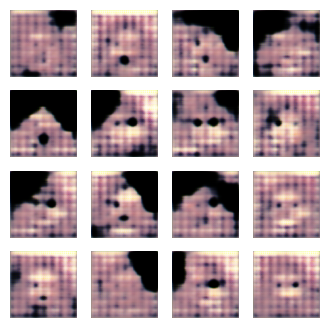

2025-03-16 08:00:54.510131: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 19/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 3.4022 | Discriminator Loss: 0.3267 | Time: 240.51 sec


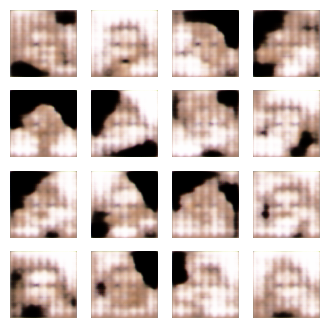

2025-03-16 08:05:00.496656: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 20/100: 100%|█████████████████████████████| 79/79 [04:05<00:00,  3.11s/it]

Generator Loss: 2.6172 | Discriminator Loss: 0.3632 | Time: 245.75 sec


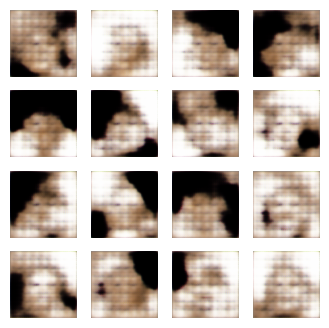

2025-03-16 08:09:00.420984: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 21/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 3.5138 | Discriminator Loss: 0.2859 | Time: 239.69 sec


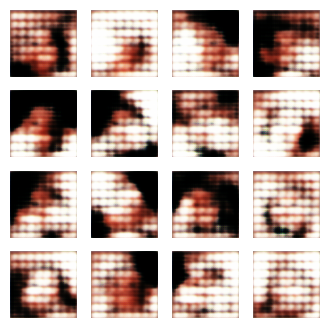

2025-03-16 08:13:00.491279: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 22/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.04s/it]

Generator Loss: 4.1123 | Discriminator Loss: 0.5507 | Time: 239.84 sec


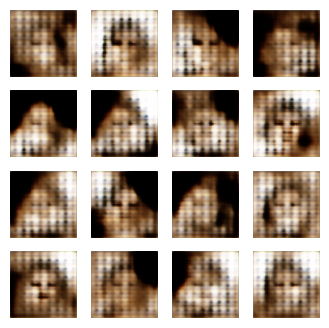

2025-03-16 08:16:59.908563: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 23/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 4.4103 | Discriminator Loss: 0.4898 | Time: 239.18 sec


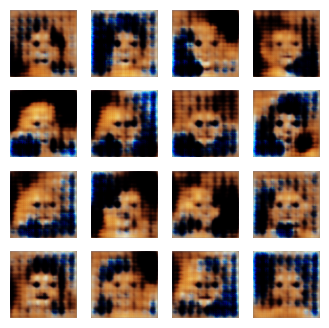

2025-03-16 08:20:58.535405: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 24/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 3.1975 | Discriminator Loss: 0.5075 | Time: 238.41 sec


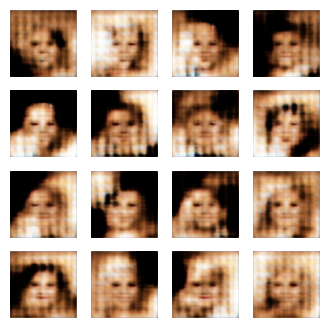

2025-03-16 08:24:58.542014: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 25/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 2.5545 | Discriminator Loss: 0.5404 | Time: 239.78 sec


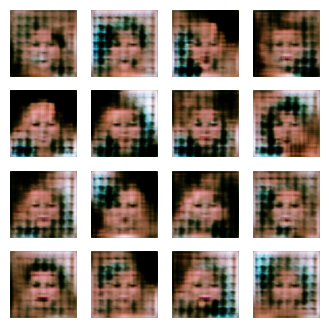

2025-03-16 08:28:58.529834: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 26/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 2.7393 | Discriminator Loss: 0.6605 | Time: 239.76 sec


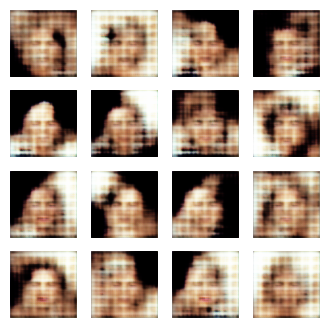

2025-03-16 08:33:05.350390: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 27/100: 100%|█████████████████████████████| 79/79 [04:06<00:00,  3.12s/it]

Generator Loss: 2.4741 | Discriminator Loss: 0.4770 | Time: 246.61 sec


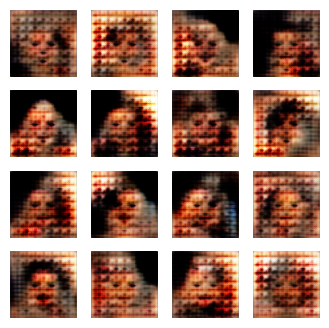

2025-03-16 08:37:16.225342: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 28/100: 100%|█████████████████████████████| 79/79 [04:10<00:00,  3.17s/it]

Generator Loss: 2.9250 | Discriminator Loss: 0.5775 | Time: 250.61 sec


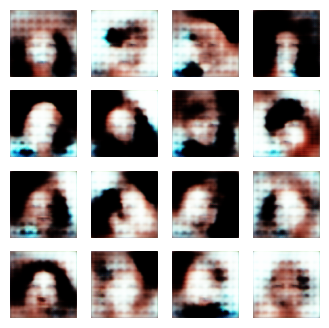

2025-03-16 08:41:18.643290: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 29/100: 100%|█████████████████████████████| 79/79 [04:02<00:00,  3.07s/it]

Generator Loss: 3.0874 | Discriminator Loss: 0.3570 | Time: 242.16 sec


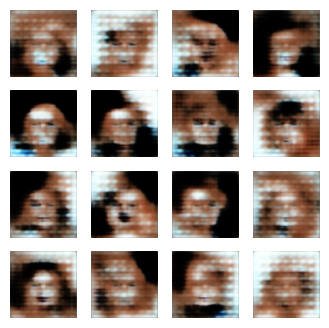

2025-03-16 08:45:21.942060: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 30/100: 100%|█████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 3.2567 | Discriminator Loss: 0.3378 | Time: 243.06 sec


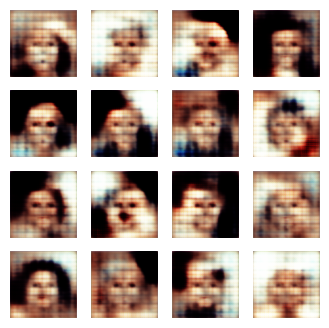

2025-03-16 08:49:26.923636: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 31/100: 100%|█████████████████████████████| 79/79 [04:04<00:00,  3.10s/it]

Generator Loss: 2.6833 | Discriminator Loss: 0.4673 | Time: 244.75 sec


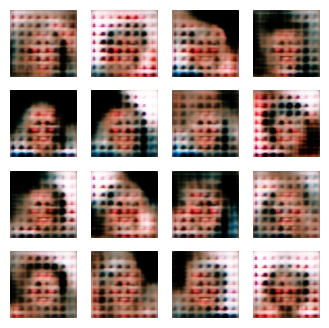

2025-03-16 08:53:30.699209: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 32/100: 100%|█████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 3.8459 | Discriminator Loss: 0.3175 | Time: 243.55 sec


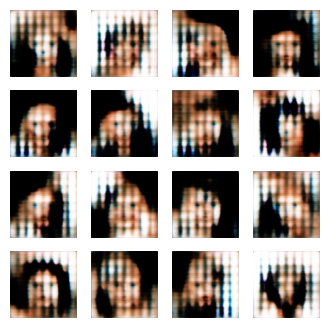

2025-03-16 08:57:32.602199: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 33/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]

Generator Loss: 2.5793 | Discriminator Loss: 0.4731 | Time: 241.67 sec


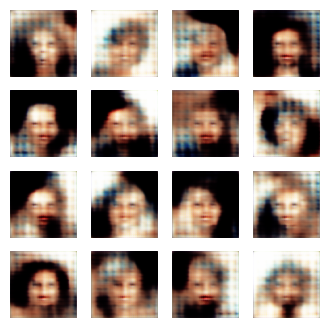

2025-03-16 09:01:36.249296: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 34/100: 100%|█████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 3.0075 | Discriminator Loss: 0.3354 | Time: 243.42 sec


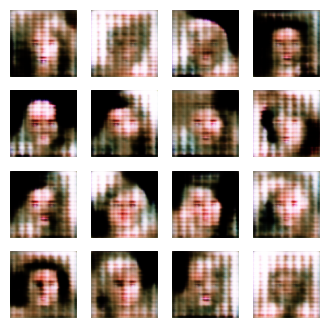

2025-03-16 09:05:40.011065: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 35/100: 100%|█████████████████████████████| 79/79 [04:03<00:00,  3.08s/it]

Generator Loss: 3.3725 | Discriminator Loss: 0.5392 | Time: 243.53 sec


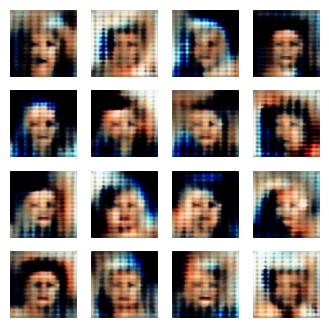

2025-03-16 09:09:41.244235: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 36/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.05s/it]

Generator Loss: 3.6484 | Discriminator Loss: 0.3853 | Time: 241.00 sec


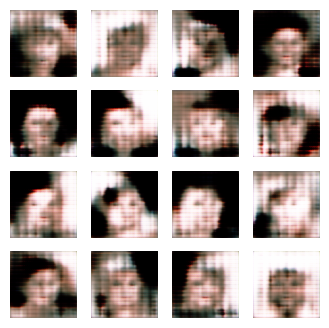

2025-03-16 09:13:37.721295: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 37/100: 100%|█████████████████████████████| 79/79 [03:56<00:00,  2.99s/it]

Generator Loss: 4.2958 | Discriminator Loss: 0.3522 | Time: 236.26 sec


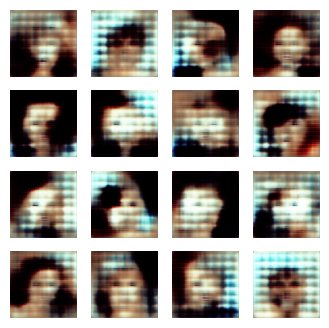

2025-03-16 09:17:36.489522: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 38/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 3.3768 | Discriminator Loss: 0.2879 | Time: 238.55 sec


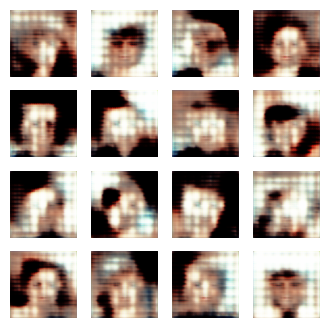

2025-03-16 09:21:37.219460: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 39/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 3.8112 | Discriminator Loss: 0.2738 | Time: 240.51 sec


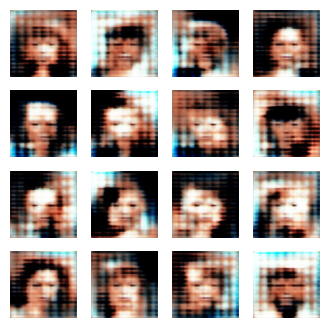

2025-03-16 09:25:31.389600: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 40/100: 100%|█████████████████████████████| 79/79 [03:53<00:00,  2.96s/it]

Generator Loss: 3.3388 | Discriminator Loss: 0.3671 | Time: 233.94 sec


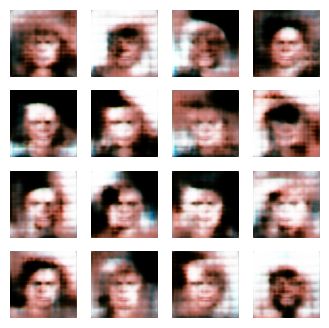

2025-03-16 09:29:24.495799: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 41/100: 100%|█████████████████████████████| 79/79 [03:52<00:00,  2.95s/it]

Generator Loss: 4.1248 | Discriminator Loss: 0.3343 | Time: 232.88 sec


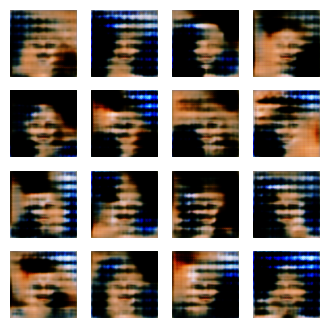

2025-03-16 09:33:26.313337: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 42/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]


Generator Loss: 5.1055 | Discriminator Loss: 0.3443 | Time: 241.60 sec


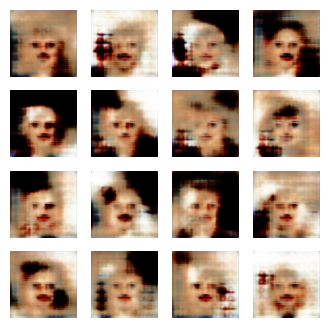

2025-03-16 09:37:25.813028: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 43/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 2.8730 | Discriminator Loss: 0.4903 | Time: 239.15 sec


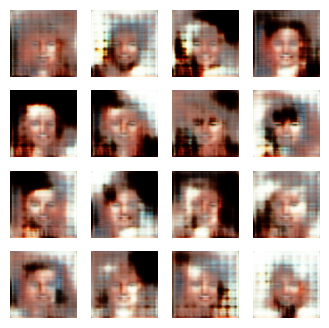

2025-03-16 09:41:24.599567: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 44/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 2.7831 | Discriminator Loss: 0.3739 | Time: 238.56 sec


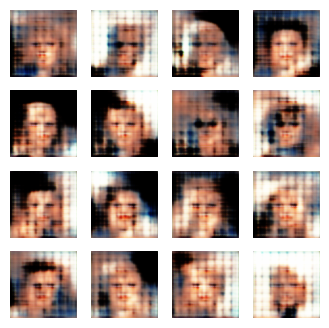

2025-03-16 09:45:19.609932: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 45/100: 100%|█████████████████████████████| 79/79 [03:54<00:00,  2.97s/it]

Generator Loss: 3.6692 | Discriminator Loss: 0.3367 | Time: 234.78 sec


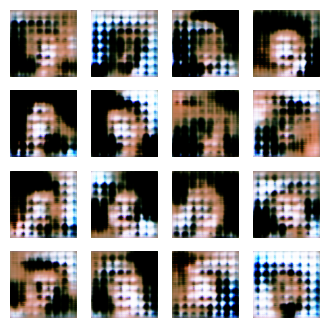

2025-03-16 09:49:18.044610: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 46/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]


Generator Loss: 5.1013 | Discriminator Loss: 0.1448 | Time: 238.21 sec


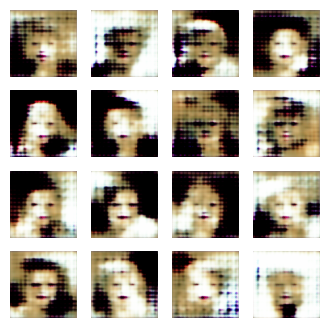

2025-03-16 09:53:16.997214: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 47/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 4.8950 | Discriminator Loss: 0.3012 | Time: 238.61 sec


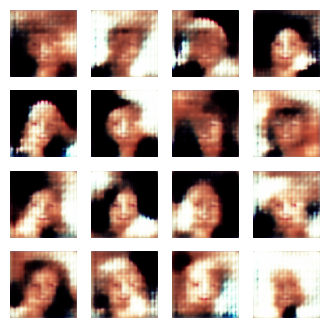

2025-03-16 09:57:17.699748: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 48/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 3.4491 | Discriminator Loss: 0.3935 | Time: 240.47 sec


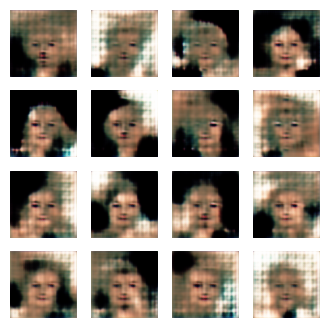

2025-03-16 10:01:19.836629: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 49/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]

Generator Loss: 3.3882 | Discriminator Loss: 0.3022 | Time: 241.91 sec


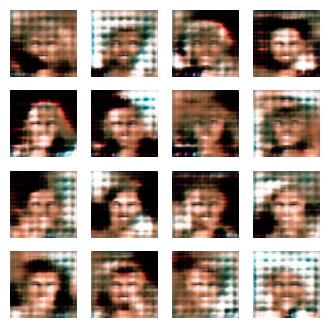

2025-03-16 10:05:26.022537: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 50/100: 100%|█████████████████████████████| 79/79 [04:05<00:00,  3.11s/it]


Generator Loss: 4.1549 | Discriminator Loss: 0.4055 | Time: 245.94 sec


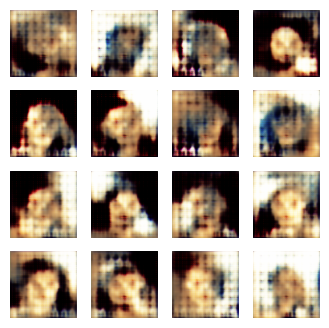

2025-03-16 10:09:23.622024: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 51/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.00s/it]

Generator Loss: 5.9642 | Discriminator Loss: 0.2867 | Time: 237.24 sec


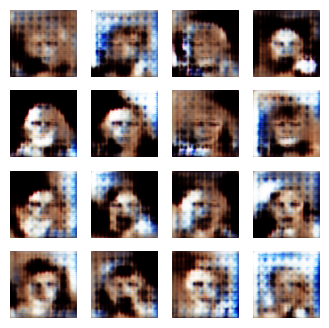

2025-03-16 10:13:19.658960: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 52/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 3.2668 | Discriminator Loss: 0.2673 | Time: 235.80 sec


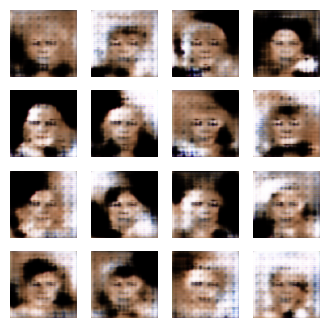

2025-03-16 10:17:22.542682: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 53/100: 100%|█████████████████████████████| 79/79 [04:02<00:00,  3.07s/it]

Generator Loss: 3.7388 | Discriminator Loss: 0.2496 | Time: 242.61 sec


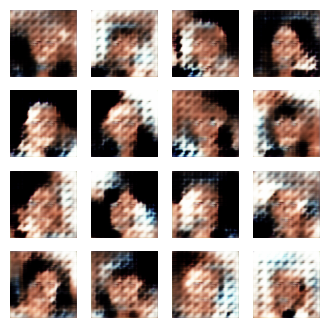

2025-03-16 10:21:20.785085: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 54/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 3.4081 | Discriminator Loss: 0.2788 | Time: 238.01 sec


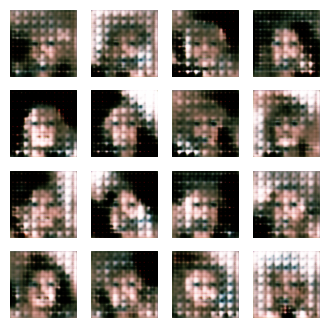

2025-03-16 10:25:23.005711: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 55/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]

Generator Loss: 4.5517 | Discriminator Loss: 0.2931 | Time: 241.97 sec


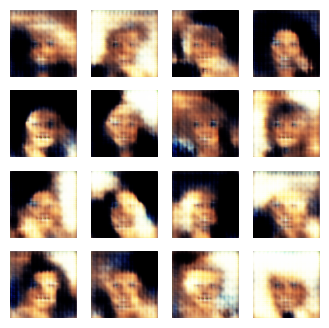

2025-03-16 10:29:12.992320: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 56/100: 100%|█████████████████████████████| 79/79 [03:49<00:00,  2.91s/it]

Generator Loss: 3.9975 | Discriminator Loss: 0.2769 | Time: 229.77 sec


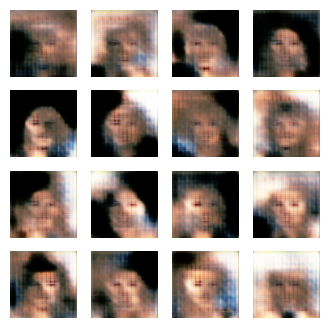

2025-03-16 10:33:10.573825: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 57/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.00s/it]

Generator Loss: 3.7760 | Discriminator Loss: 0.2702 | Time: 237.34 sec


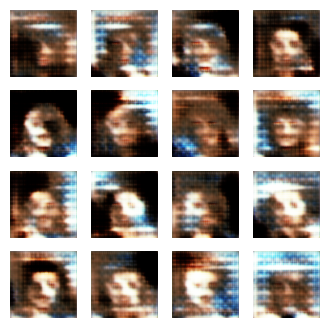

2025-03-16 10:37:02.758126: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 58/100: 100%|█████████████████████████████| 79/79 [03:51<00:00,  2.94s/it]

Generator Loss: 3.6648 | Discriminator Loss: 0.2652 | Time: 231.97 sec


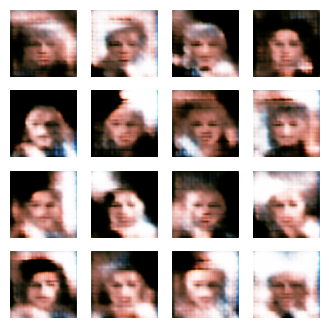

2025-03-16 10:40:58.029572: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 59/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 4.2689 | Discriminator Loss: 0.3184 | Time: 235.05 sec


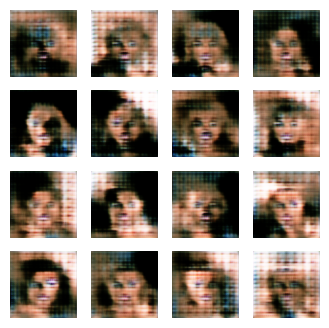

2025-03-16 10:45:02.562027: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 60/100: 100%|█████████████████████████████| 79/79 [04:04<00:00,  3.09s/it]

Generator Loss: 4.8034 | Discriminator Loss: 0.4095 | Time: 244.29 sec


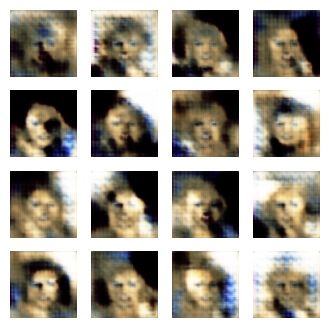

2025-03-16 10:48:59.632716: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 61/100: 100%|█████████████████████████████| 79/79 [03:56<00:00,  3.00s/it]

Generator Loss: 4.1386 | Discriminator Loss: 0.1899 | Time: 236.81 sec


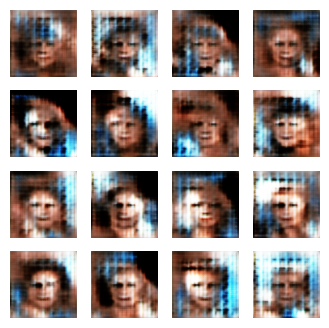

2025-03-16 10:53:00.272966: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 62/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 3.9201 | Discriminator Loss: 0.2688 | Time: 240.42 sec


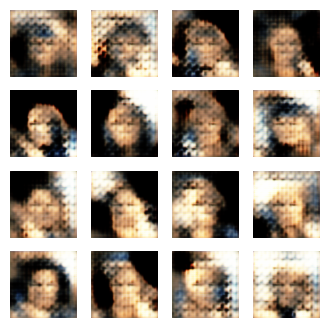

2025-03-16 10:56:54.583400: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 63/100: 100%|█████████████████████████████| 79/79 [03:54<00:00,  2.96s/it]

Generator Loss: 4.7137 | Discriminator Loss: 0.1385 | Time: 234.06 sec


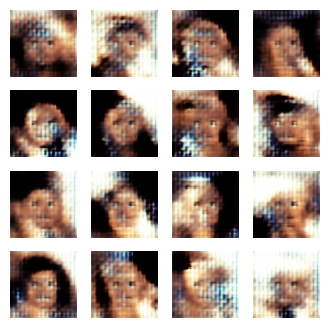

2025-03-16 11:00:52.837405: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 64/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 4.1589 | Discriminator Loss: 0.2221 | Time: 238.00 sec


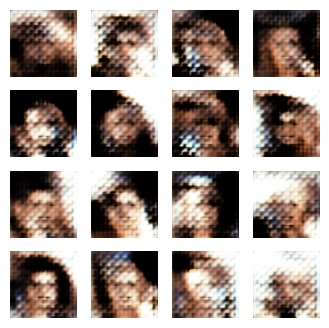

2025-03-16 11:04:51.016545: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 65/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 4.3773 | Discriminator Loss: 0.2100 | Time: 237.89 sec


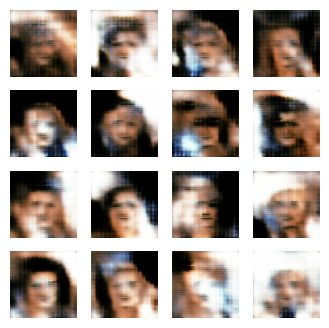

2025-03-16 11:08:49.127859: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 66/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 4.3861 | Discriminator Loss: 0.2197 | Time: 237.89 sec


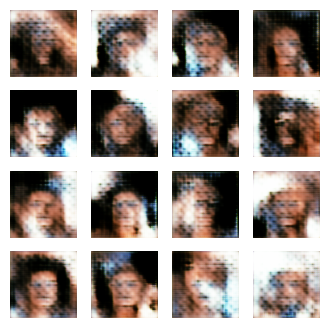

2025-03-16 11:12:44.673610: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 67/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 3.8617 | Discriminator Loss: 0.2030 | Time: 235.32 sec


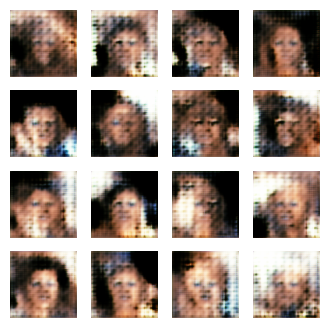

2025-03-16 11:16:42.465241: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 68/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 4.5346 | Discriminator Loss: 0.2053 | Time: 237.55 sec


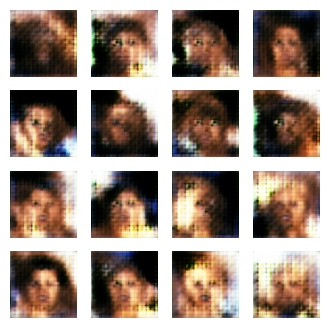

2025-03-16 11:20:34.997882: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 69/100: 100%|█████████████████████████████| 79/79 [03:52<00:00,  2.94s/it]

Generator Loss: 4.3606 | Discriminator Loss: 0.2666 | Time: 232.31 sec


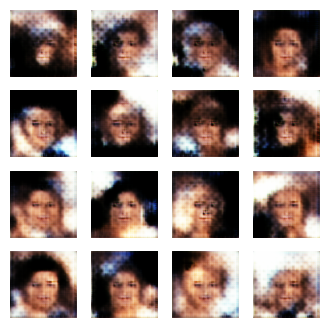

2025-03-16 11:24:31.093184: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 70/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.99s/it]

Generator Loss: 3.8518 | Discriminator Loss: 0.2388 | Time: 235.88 sec


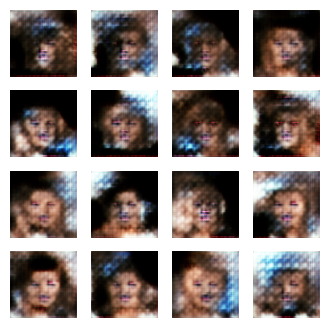

2025-03-16 11:28:26.836934: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 71/100: 100%|█████████████████████████████| 79/79 [03:55<00:00,  2.98s/it]

Generator Loss: 4.2899 | Discriminator Loss: 0.2365 | Time: 235.51 sec


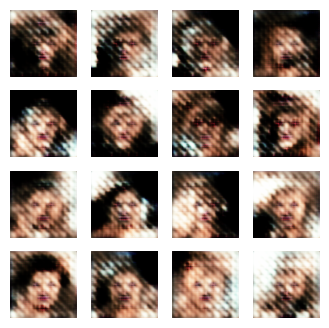

2025-03-16 11:32:20.261066: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 72/100: 100%|█████████████████████████████| 79/79 [03:53<00:00,  2.95s/it]

Generator Loss: 3.3416 | Discriminator Loss: 0.2876 | Time: 233.19 sec


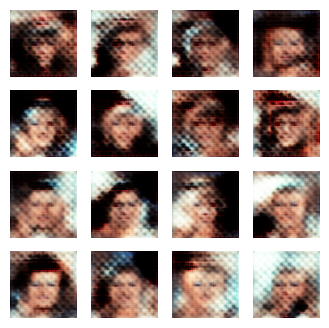

2025-03-16 11:36:12.469496: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 73/100: 100%|█████████████████████████████| 79/79 [03:51<00:00,  2.94s/it]

Generator Loss: 4.5298 | Discriminator Loss: 0.2106 | Time: 231.99 sec


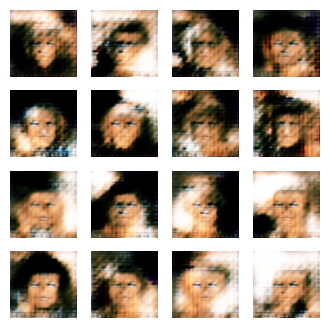

2025-03-16 11:40:10.479935: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 74/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 4.8670 | Discriminator Loss: 0.2396 | Time: 237.79 sec


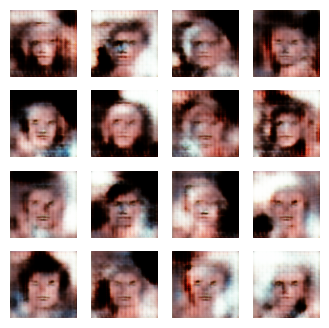

2025-03-16 11:44:02.670878: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 75/100: 100%|█████████████████████████████| 79/79 [03:51<00:00,  2.94s/it]

Generator Loss: 3.9499 | Discriminator Loss: 0.2972 | Time: 231.95 sec


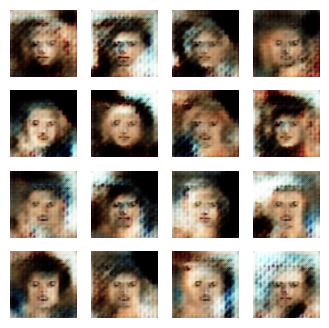

2025-03-16 11:48:02.149395: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 76/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 4.2391 | Discriminator Loss: 0.2579 | Time: 239.26 sec


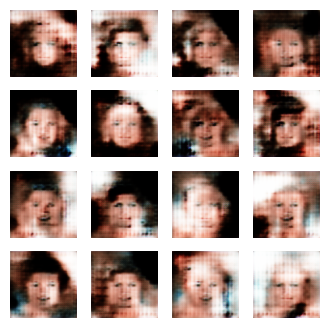

2025-03-16 11:52:03.854165: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 77/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]

Generator Loss: 4.3171 | Discriminator Loss: 0.2082 | Time: 241.47 sec


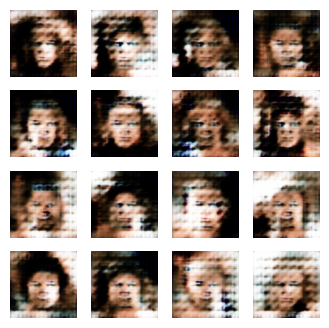

2025-03-16 11:56:03.492141: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 78/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 5.1434 | Discriminator Loss: 0.3123 | Time: 239.40 sec


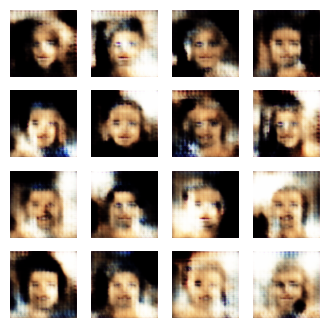

2025-03-16 12:00:04.100015: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 79/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 4.0088 | Discriminator Loss: 0.2134 | Time: 240.39 sec


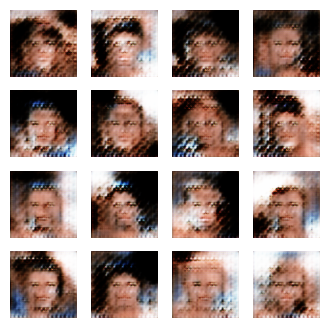

2025-03-16 12:04:03.931513: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 80/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 4.4618 | Discriminator Loss: 0.1760 | Time: 239.60 sec


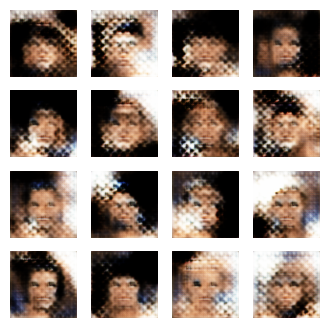

2025-03-16 12:08:10.959869: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 81/100: 100%|█████████████████████████████| 79/79 [04:06<00:00,  3.12s/it]

Generator Loss: 5.8200 | Discriminator Loss: 0.1837 | Time: 246.79 sec


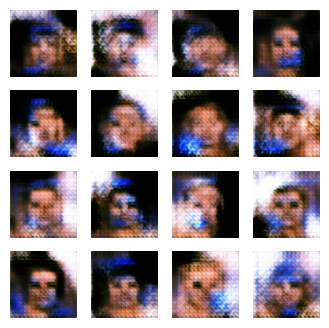

2025-03-16 12:12:10.819975: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 82/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.03s/it]

Generator Loss: 5.1157 | Discriminator Loss: 0.2532 | Time: 239.63 sec


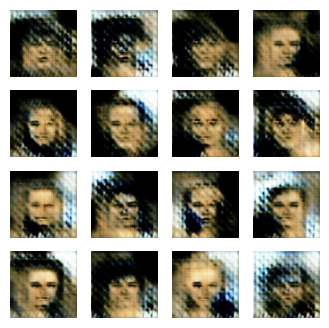

2025-03-16 12:16:11.920286: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 83/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.05s/it]

Generator Loss: 6.0396 | Discriminator Loss: 0.1815 | Time: 240.88 sec


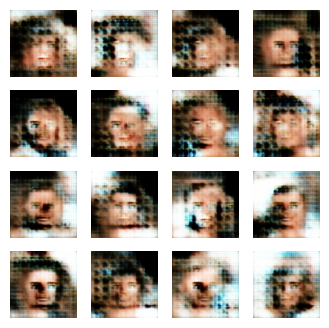

2025-03-16 12:20:16.238375: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 84/100: 100%|█████████████████████████████| 79/79 [04:04<00:00,  3.09s/it]

Generator Loss: 4.4616 | Discriminator Loss: 0.2128 | Time: 244.09 sec


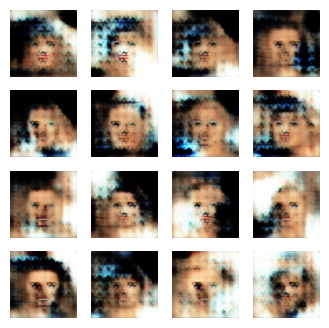

2025-03-16 12:24:16.341388: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 85/100: 100%|█████████████████████████████| 79/79 [03:59<00:00,  3.04s/it]

Generator Loss: 4.1861 | Discriminator Loss: 0.1881 | Time: 239.87 sec


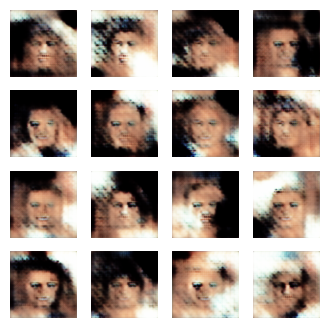

2025-03-16 12:28:14.417884: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 86/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.01s/it]

Generator Loss: 3.7571 | Discriminator Loss: 0.1662 | Time: 237.82 sec


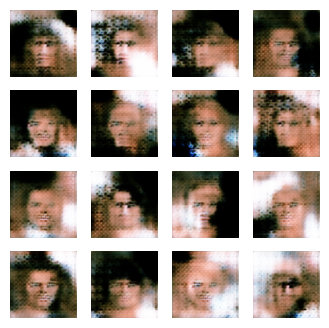

2025-03-16 12:32:13.648736: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 87/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.03s/it]

Generator Loss: 4.9399 | Discriminator Loss: 0.2408 | Time: 239.01 sec


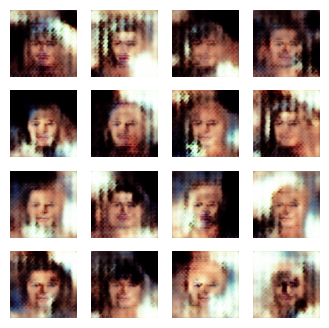

2025-03-16 12:36:19.183453: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 88/100: 100%|█████████████████████████████| 79/79 [04:05<00:00,  3.10s/it]

Generator Loss: 4.6032 | Discriminator Loss: 0.2117 | Time: 245.31 sec


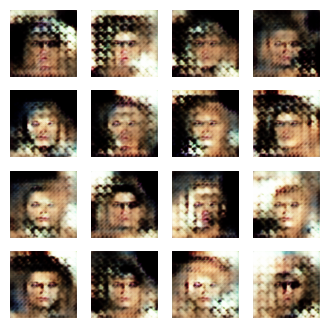

2025-03-16 12:40:26.729673: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 89/100: 100%|█████████████████████████████| 79/79 [04:07<00:00,  3.13s/it]

Generator Loss: 4.7318 | Discriminator Loss: 0.2004 | Time: 247.32 sec


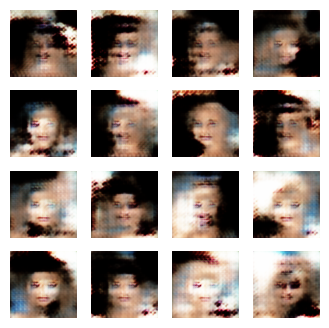

2025-03-16 12:44:35.749487: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 90/100: 100%|█████████████████████████████| 79/79 [04:08<00:00,  3.15s/it]

Generator Loss: 4.8370 | Discriminator Loss: 0.1905 | Time: 248.78 sec


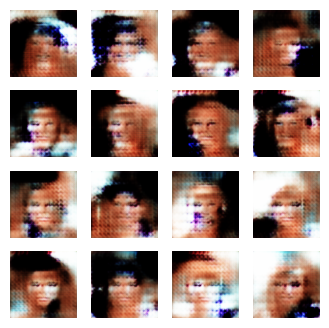

2025-03-16 12:48:37.336578: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 91/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.05s/it]


Generator Loss: 4.2589 | Discriminator Loss: 0.2042 | Time: 241.35 sec


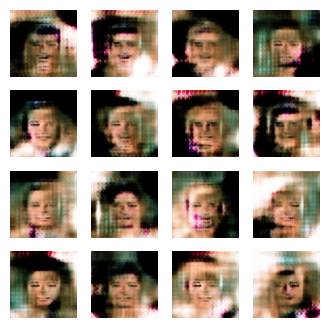

2025-03-16 12:52:39.976237: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 92/100: 100%|█████████████████████████████| 79/79 [04:02<00:00,  3.07s/it]

Generator Loss: 5.6291 | Discriminator Loss: 0.2022 | Time: 242.29 sec


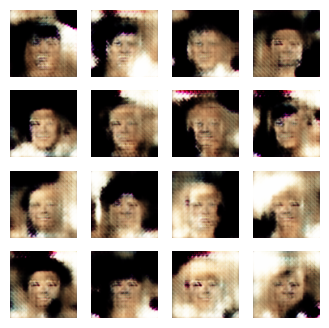

2025-03-16 12:56:38.671068: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 93/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 6.7622 | Discriminator Loss: 0.2428 | Time: 238.46 sec


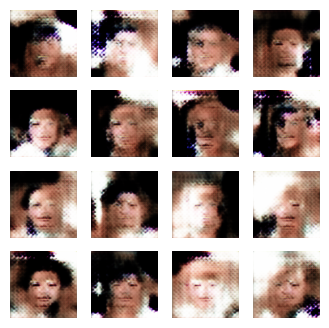

2025-03-16 13:00:36.178779: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 94/100: 100%|█████████████████████████████| 79/79 [03:57<00:00,  3.00s/it]

Generator Loss: 4.2633 | Discriminator Loss: 0.2274 | Time: 237.28 sec


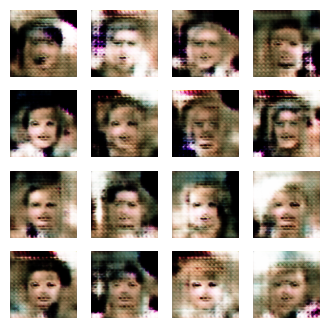

2025-03-16 13:04:34.669601: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 95/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]


Generator Loss: 4.4188 | Discriminator Loss: 0.2320 | Time: 238.27 sec


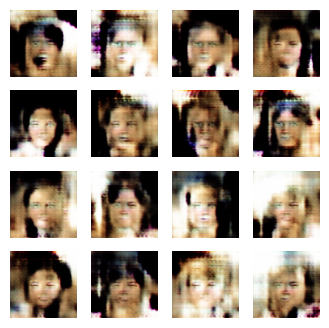

2025-03-16 13:08:35.241400: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 96/100: 100%|█████████████████████████████| 79/79 [04:00<00:00,  3.04s/it]

Generator Loss: 4.8404 | Discriminator Loss: 0.1615 | Time: 240.22 sec


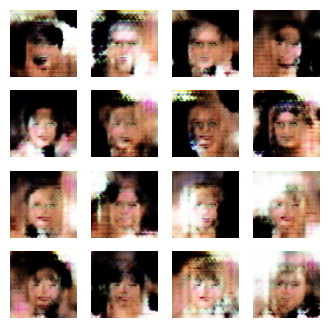

2025-03-16 13:12:34.054114: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 97/100: 100%|█████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]

Generator Loss: 4.5423 | Discriminator Loss: 0.1859 | Time: 238.58 sec


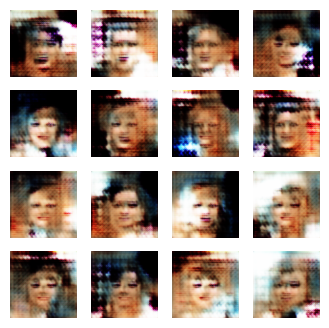

2025-03-16 13:16:35.797745: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 98/100: 100%|█████████████████████████████| 79/79 [04:01<00:00,  3.06s/it]

Generator Loss: 4.4781 | Discriminator Loss: 0.2031 | Time: 241.50 sec


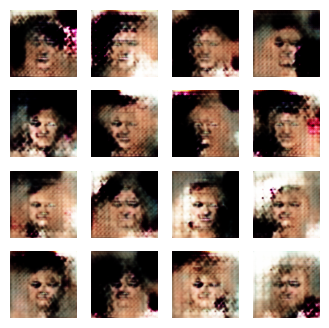

2025-03-16 13:20:38.817022: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 99/100: 100%|█████████████████████████████| 79/79 [04:02<00:00,  3.07s/it]


Generator Loss: 5.7747 | Discriminator Loss: 0.2690 | Time: 242.75 sec


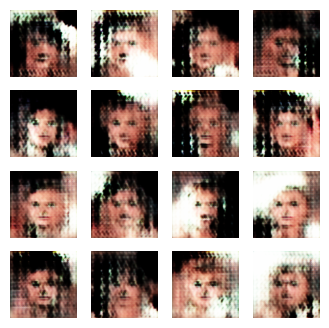

2025-03-16 13:24:39.789488: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 100/100: 100%|████████████████████████████| 79/79 [04:00<00:00,  3.05s/it]

Generator Loss: 4.8387 | Discriminator Loss: 0.1579 | Time: 240.61 sec


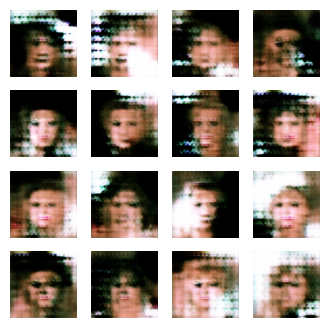


🎉 Total Training Time: 24014.43 sec


In [38]:
train(dataset, 100)

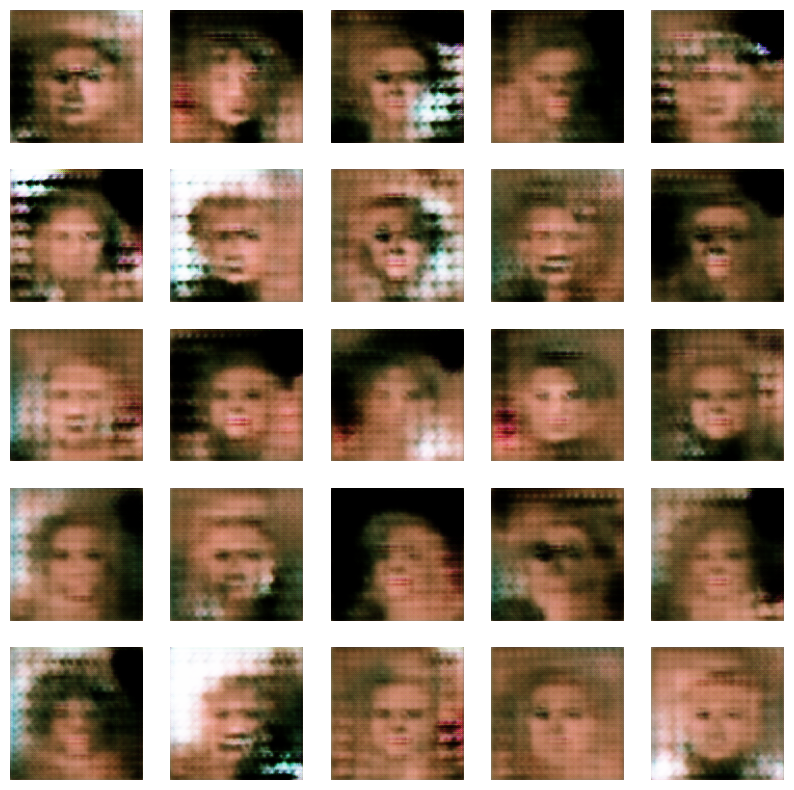

In [63]:
plot_generated_images(5)

In [31]:
generator.load_weights('generator1.weights.h5')
discriminator.load_weights('discriminator1.weights.h5')

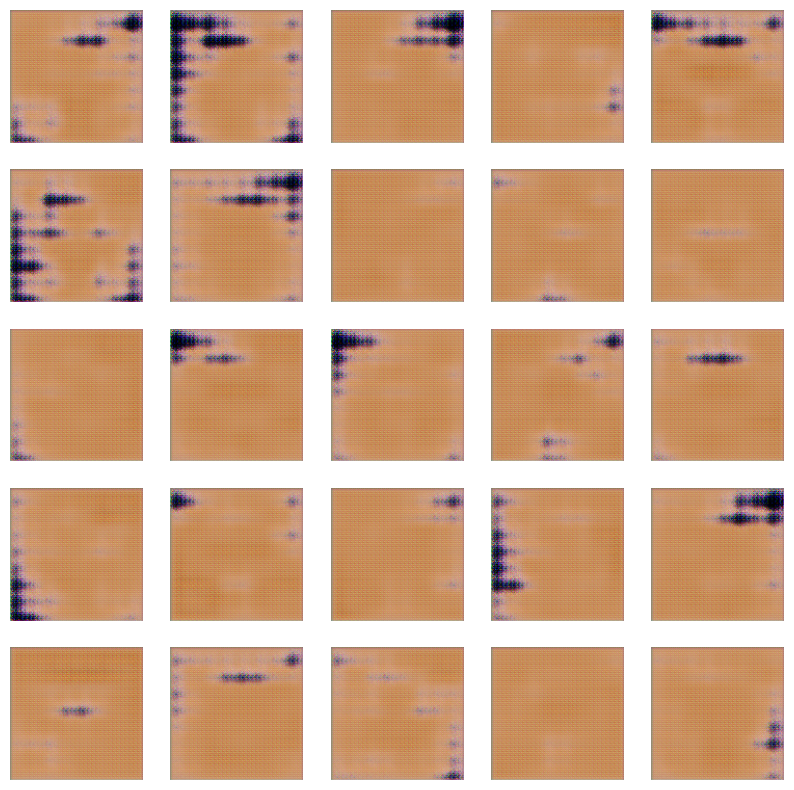

In [32]:
plot_generated_images(5)

2025-03-22 14:47:12.671193: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 1/100: 100%|██████████████████████████████| 79/79 [02:54<00:00,  2.21s/it]


Generator Loss: 5.3988 | Discriminator Loss: 0.1586 | Time: 174.42 sec


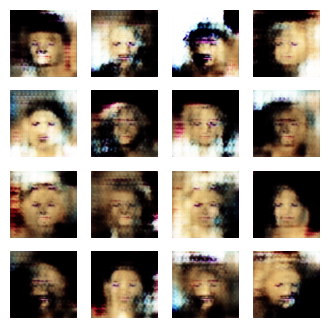

2025-03-22 14:50:44.521186: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 2/100: 100%|██████████████████████████████| 79/79 [03:31<00:00,  2.67s/it]

Generator Loss: 5.8712 | Discriminator Loss: 0.1168 | Time: 211.32 sec


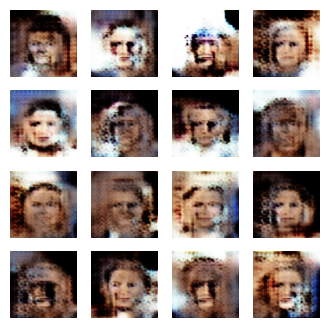

2025-03-22 14:54:37.352091: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 3/100: 100%|██████████████████████████████| 79/79 [03:52<00:00,  2.94s/it]

Generator Loss: 5.6387 | Discriminator Loss: 0.1367 | Time: 232.62 sec


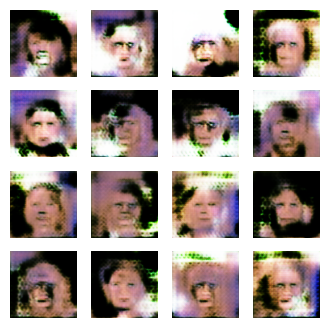

2025-03-22 14:58:33.496643: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 4/100: 100%|██████████████████████████████| 79/79 [03:55<00:00,  2.99s/it]

Generator Loss: 5.7478 | Discriminator Loss: 0.1817 | Time: 235.91 sec


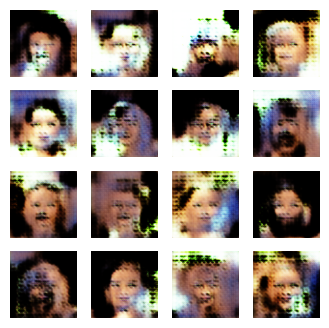

2025-03-22 15:02:27.406478: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 5/100: 100%|██████████████████████████████| 79/79 [03:53<00:00,  2.96s/it]

Generator Loss: 5.3386 | Discriminator Loss: 0.1413 | Time: 233.66 sec


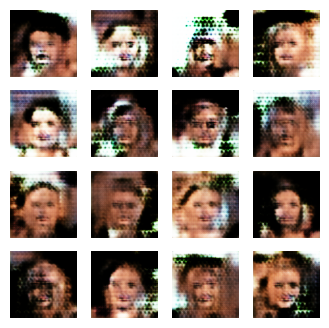

2025-03-22 15:06:22.431914: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 6/100: 100%|██████████████████████████████| 79/79 [03:54<00:00,  2.97s/it]

Generator Loss: 5.9598 | Discriminator Loss: 0.1288 | Time: 234.79 sec


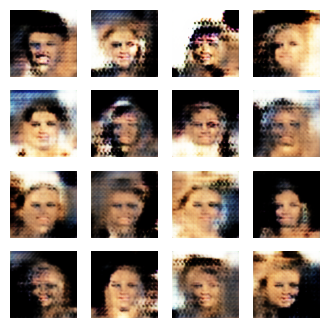

2025-03-22 15:10:07.800658: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 7/100: 100%|██████████████████████████████| 79/79 [03:45<00:00,  2.85s/it]

Generator Loss: 6.2978 | Discriminator Loss: 0.1388 | Time: 225.16 sec


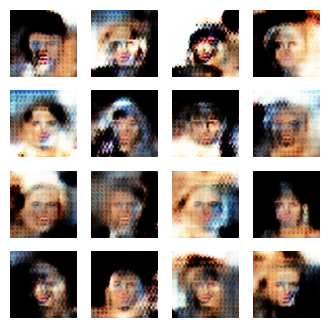

2025-03-22 15:14:06.510753: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 8/100: 100%|██████████████████████████████| 79/79 [03:58<00:00,  3.02s/it]


Generator Loss: 6.8002 | Discriminator Loss: 0.1650 | Time: 238.48 sec


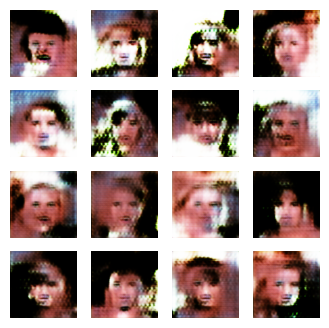

2025-03-22 15:18:13.939710: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 9/100: 100%|██████████████████████████████| 79/79 [04:07<00:00,  3.13s/it]


Generator Loss: 5.1633 | Discriminator Loss: 0.1261 | Time: 247.09 sec


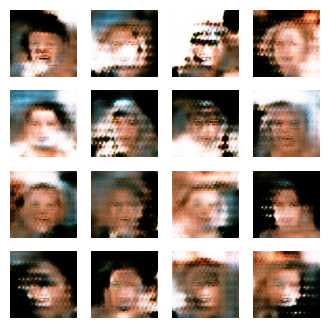

2025-03-22 15:24:07.204470: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 10/100: 100%|█████████████████████████████| 79/79 [05:52<00:00,  4.47s/it]


Generator Loss: 5.7743 | Discriminator Loss: 0.1124 | Time: 352.96 sec


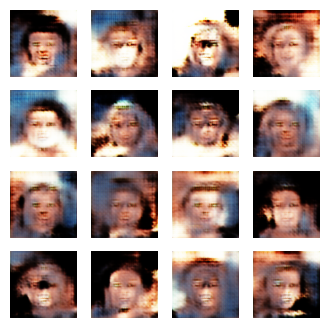

2025-03-22 15:30:59.947195: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 11/100: 100%|█████████████████████████████| 79/79 [06:52<00:00,  5.22s/it]


Generator Loss: 5.4752 | Discriminator Loss: 0.0992 | Time: 412.39 sec


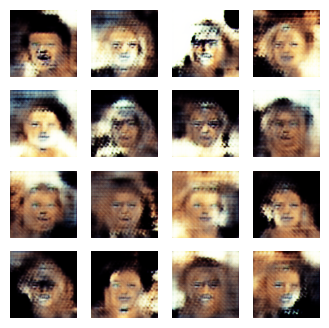

2025-03-22 15:36:47.506402: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 12/100: 100%|█████████████████████████████| 79/79 [05:47<00:00,  4.39s/it]


Generator Loss: 5.9130 | Discriminator Loss: 0.1255 | Time: 347.05 sec


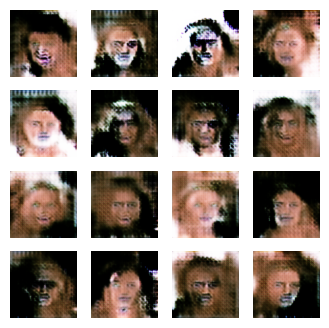

2025-03-22 15:42:54.372711: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 13/100: 100%|█████████████████████████████| 79/79 [06:06<00:00,  4.64s/it]

Generator Loss: 5.4782 | Discriminator Loss: 0.0864 | Time: 366.39 sec


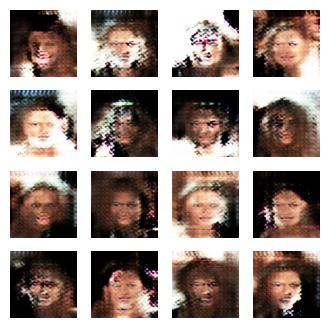

2025-03-22 15:48:34.471893: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 14/100: 100%|█████████████████████████████| 79/79 [05:39<00:00,  4.30s/it]

Generator Loss: 5.7834 | Discriminator Loss: 0.1413 | Time: 339.85 sec


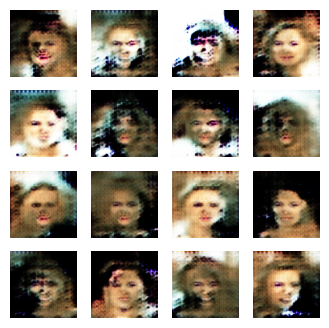

2025-03-22 15:54:51.317455: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 15/100: 100%|█████████████████████████████| 79/79 [06:16<00:00,  4.77s/it]


Generator Loss: 6.6427 | Discriminator Loss: 0.1434 | Time: 376.59 sec


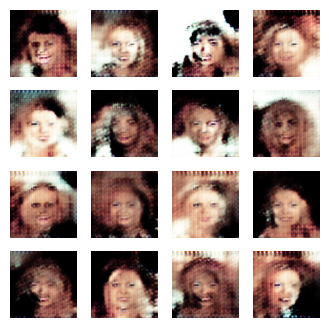

2025-03-22 16:00:21.686168: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 16/100: 100%|█████████████████████████████| 79/79 [05:29<00:00,  4.18s/it]


Generator Loss: 5.5325 | Discriminator Loss: 0.1565 | Time: 329.93 sec


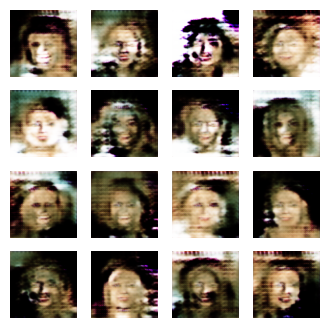

2025-03-22 16:05:57.305223: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 17/100: 100%|█████████████████████████████| 79/79 [05:35<00:00,  4.24s/it]


Generator Loss: 5.9295 | Discriminator Loss: 0.1079 | Time: 335.34 sec


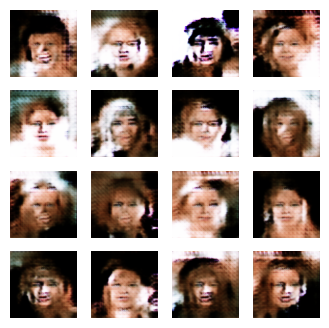

2025-03-22 16:11:01.422378: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 18/100: 100%|█████████████████████████████| 79/79 [05:03<00:00,  3.85s/it]


Generator Loss: 5.5920 | Discriminator Loss: 0.0992 | Time: 303.82 sec


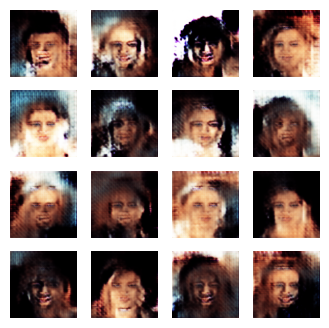

2025-03-22 16:15:58.413649: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 19/100: 100%|█████████████████████████████| 79/79 [04:56<00:00,  3.75s/it]


Generator Loss: 5.9075 | Discriminator Loss: 0.0939 | Time: 296.57 sec


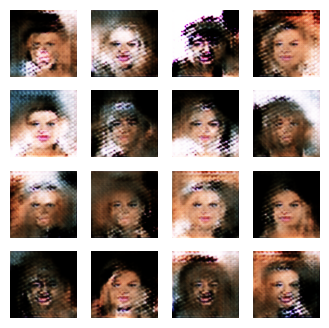

2025-03-22 16:20:57.384948: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 20/100: 100%|█████████████████████████████| 79/79 [04:58<00:00,  3.78s/it]


Generator Loss: 6.2610 | Discriminator Loss: 0.1784 | Time: 298.68 sec


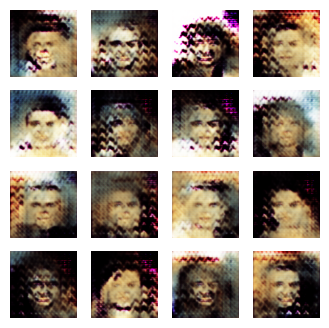

2025-03-22 16:25:58.212706: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 21/100: 100%|█████████████████████████████| 79/79 [05:00<00:00,  3.80s/it]


Generator Loss: 6.8997 | Discriminator Loss: 0.0993 | Time: 300.56 sec


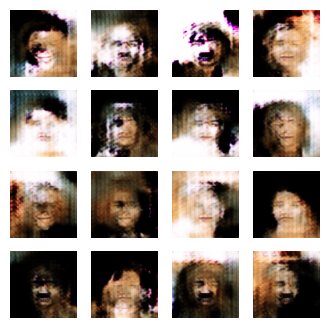

2025-03-22 16:30:55.031591: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 22/100: 100%|█████████████████████████████| 79/79 [04:56<00:00,  3.75s/it]


Generator Loss: 5.5491 | Discriminator Loss: 0.0923 | Time: 296.53 sec


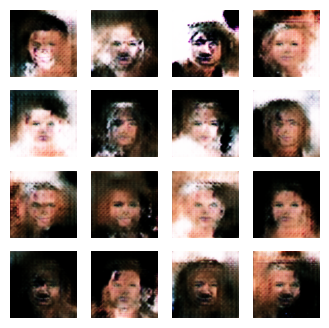

2025-03-22 16:35:45.641863: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 23/100: 100%|█████████████████████████████| 79/79 [04:50<00:00,  3.67s/it]


Generator Loss: 5.8199 | Discriminator Loss: 0.1213 | Time: 290.25 sec


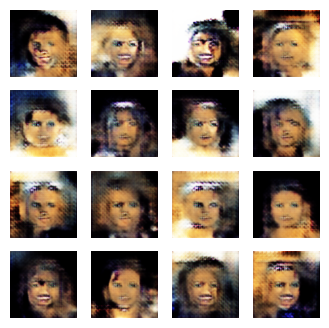

2025-03-22 16:40:37.335687: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 24/100: 100%|█████████████████████████████| 79/79 [04:51<00:00,  3.69s/it]


Generator Loss: 6.5824 | Discriminator Loss: 0.1229 | Time: 291.35 sec


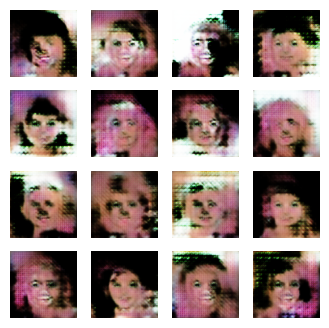

2025-03-22 16:45:36.264517: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 25/100: 100%|█████████████████████████████| 79/79 [04:58<00:00,  3.78s/it]

Generator Loss: 5.5587 | Discriminator Loss: 0.1021 | Time: 298.64 sec


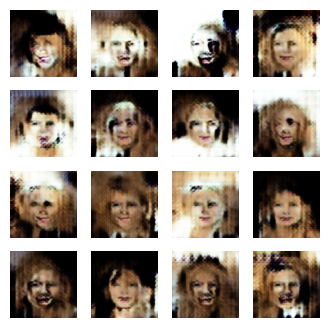

2025-03-22 16:50:16.272617: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 26/100: 100%|█████████████████████████████| 79/79 [04:39<00:00,  3.54s/it]

Generator Loss: 5.5103 | Discriminator Loss: 0.1002 | Time: 279.75 sec


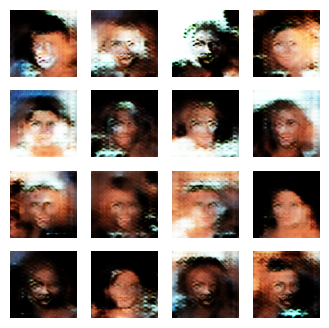

2025-03-22 16:54:52.000643: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 27/100: 100%|█████████████████████████████| 79/79 [04:35<00:00,  3.49s/it]

Generator Loss: 5.7033 | Discriminator Loss: 0.1317 | Time: 275.48 sec


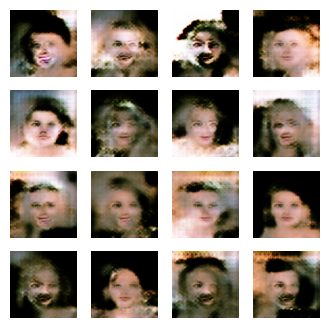

2025-03-22 16:59:27.082185: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 28/100: 100%|█████████████████████████████| 79/79 [04:34<00:00,  3.48s/it]

Generator Loss: 6.5574 | Discriminator Loss: 0.2596 | Time: 274.83 sec


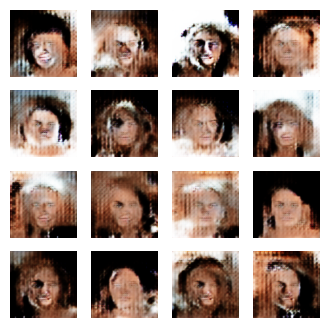

2025-03-22 17:04:09.394386: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 29/100: 100%|█████████████████████████████| 79/79 [04:42<00:00,  3.57s/it]


Generator Loss: 4.8833 | Discriminator Loss: 0.2057 | Time: 282.05 sec


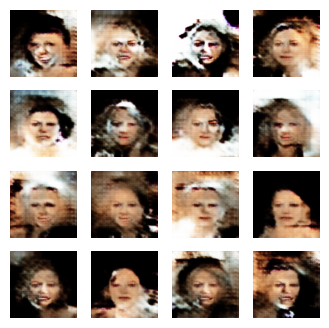

2025-03-22 17:08:46.802479: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 30/100: 100%|█████████████████████████████| 79/79 [04:36<00:00,  3.51s/it]

Generator Loss: 4.6000 | Discriminator Loss: 0.1256 | Time: 277.01 sec


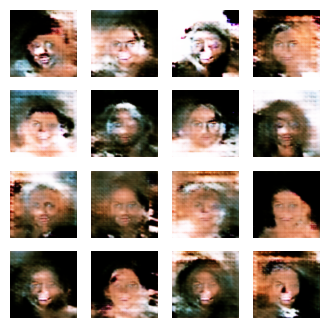

2025-03-22 17:13:35.920172: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 31/100: 100%|█████████████████████████████| 79/79 [04:48<00:00,  3.66s/it]

Generator Loss: 5.1855 | Discriminator Loss: 0.1286 | Time: 288.86 sec


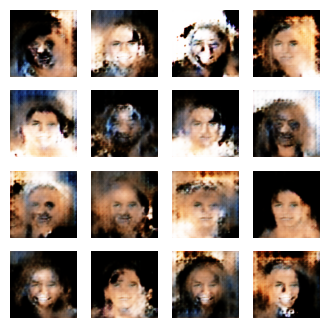

2025-03-22 17:18:23.385675: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 32/100: 100%|█████████████████████████████| 79/79 [04:47<00:00,  3.64s/it]


Generator Loss: 5.9480 | Discriminator Loss: 0.1156 | Time: 287.22 sec


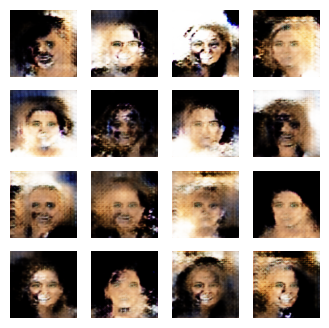

2025-03-22 17:23:05.576209: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 33/100: 100%|█████████████████████████████| 79/79 [04:41<00:00,  3.57s/it]

Generator Loss: 5.3053 | Discriminator Loss: 0.1220 | Time: 281.90 sec


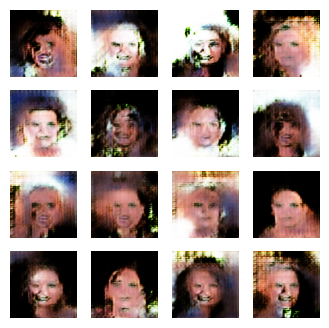

2025-03-22 17:27:52.578097: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 34/100: 100%|█████████████████████████████| 79/79 [04:46<00:00,  3.63s/it]

Generator Loss: 5.5719 | Discriminator Loss: 0.1335 | Time: 286.76 sec


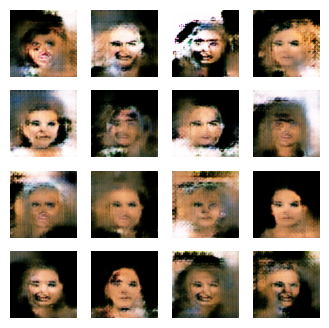

2025-03-22 17:32:47.233274: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 35/100: 100%|█████████████████████████████| 79/79 [04:54<00:00,  3.73s/it]

Generator Loss: 7.0498 | Discriminator Loss: 0.1207 | Time: 294.38 sec


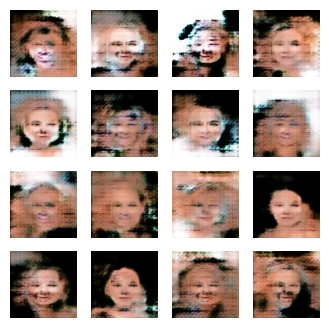

2025-03-22 17:37:31.187743: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 36/100: 100%|█████████████████████████████| 79/79 [04:43<00:00,  3.59s/it]


Generator Loss: 6.0905 | Discriminator Loss: 0.1219 | Time: 283.69 sec


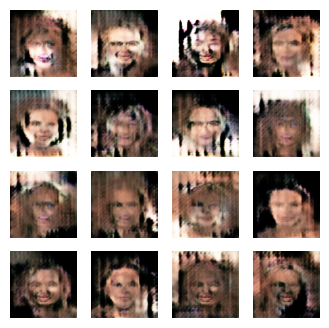

2025-03-22 17:42:12.550614: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 37/100: 100%|█████████████████████████████| 79/79 [04:40<00:00,  3.56s/it]

Generator Loss: 6.2492 | Discriminator Loss: 0.1102 | Time: 280.99 sec


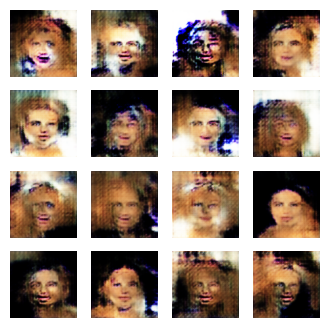

2025-03-22 17:46:33.782716: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 38/100: 100%|█████████████████████████████| 79/79 [04:20<00:00,  3.30s/it]

Generator Loss: 5.4151 | Discriminator Loss: 0.1386 | Time: 260.97 sec


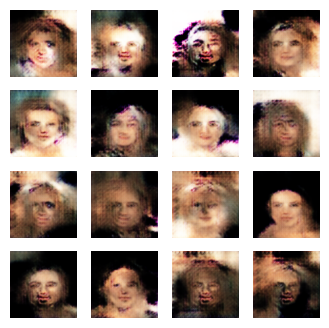

2025-03-22 17:50:57.241963: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 39/100: 100%|█████████████████████████████| 79/79 [04:23<00:00,  3.33s/it]

Generator Loss: 5.3086 | Discriminator Loss: 0.1325 | Time: 263.20 sec


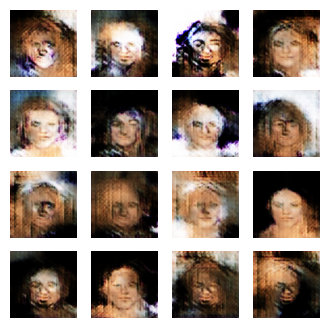

2025-03-22 17:55:29.650020: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 40/100: 100%|█████████████████████████████| 79/79 [04:32<00:00,  3.44s/it]

Generator Loss: 5.0807 | Discriminator Loss: 0.1337 | Time: 272.03 sec


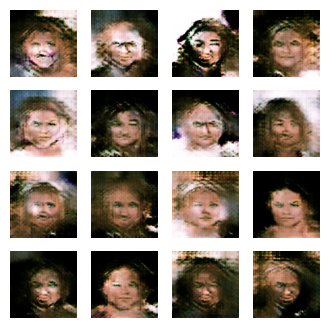

2025-03-22 18:00:03.534088: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 41/100: 100%|█████████████████████████████| 79/79 [04:33<00:00,  3.46s/it]


Generator Loss: 5.7370 | Discriminator Loss: 0.1051 | Time: 273.62 sec


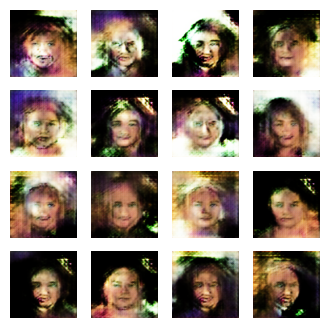

2025-03-22 18:04:56.184200: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 42/100: 100%|█████████████████████████████| 79/79 [04:52<00:00,  3.70s/it]


Generator Loss: 5.7092 | Discriminator Loss: 0.2033 | Time: 292.37 sec


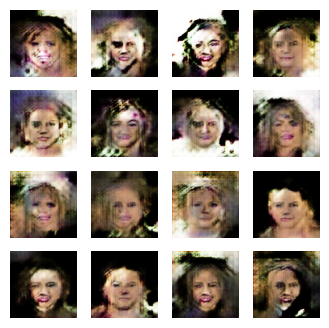

2025-03-22 18:09:39.862751: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 43/100: 100%|█████████████████████████████| 79/79 [04:43<00:00,  3.59s/it]


Generator Loss: 4.9318 | Discriminator Loss: 0.1247 | Time: 283.37 sec


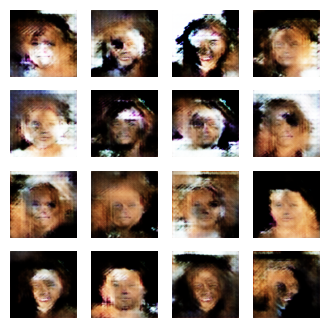

2025-03-22 18:14:23.456031: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 44/100: 100%|█████████████████████████████| 79/79 [04:43<00:00,  3.58s/it]

Generator Loss: 5.3286 | Discriminator Loss: 0.1268 | Time: 283.21 sec


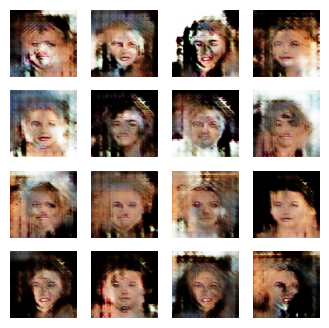

2025-03-22 18:19:02.648079: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 45/100: 100%|█████████████████████████████| 79/79 [04:38<00:00,  3.53s/it]

Generator Loss: 5.1231 | Discriminator Loss: 0.1005 | Time: 278.92 sec


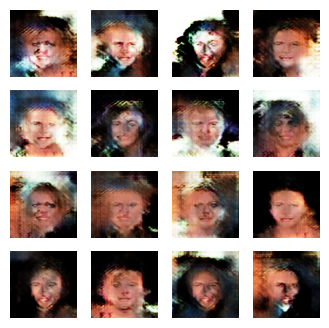

2025-03-22 18:23:48.127826: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 46/100: 100%|█████████████████████████████| 79/79 [04:45<00:00,  3.61s/it]


Generator Loss: 5.4696 | Discriminator Loss: 0.1090 | Time: 285.22 sec


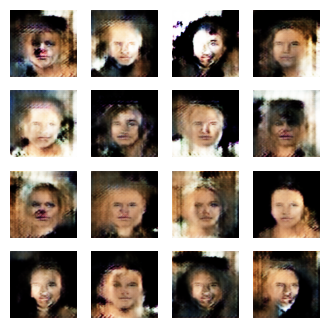

2025-03-22 18:28:35.830976: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 47/100: 100%|█████████████████████████████| 79/79 [04:47<00:00,  3.64s/it]

Generator Loss: 5.3638 | Discriminator Loss: 0.1334 | Time: 287.29 sec


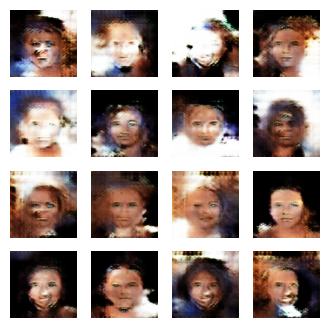

2025-03-22 18:33:22.835449: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 48/100: 100%|█████████████████████████████| 79/79 [04:46<00:00,  3.63s/it]

Generator Loss: 5.6315 | Discriminator Loss: 0.1333 | Time: 286.74 sec


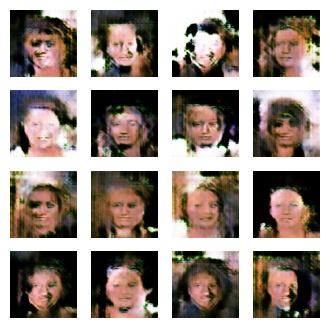

2025-03-22 18:38:07.487466: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 49/100: 100%|█████████████████████████████| 79/79 [04:44<00:00,  3.60s/it]


Generator Loss: 5.4133 | Discriminator Loss: 0.1095 | Time: 284.40 sec


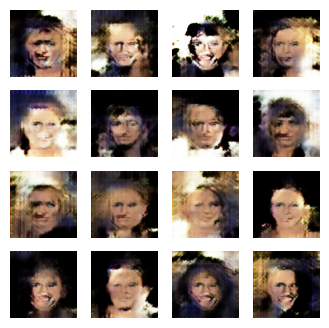

2025-03-22 18:42:58.531867: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 50/100: 100%|█████████████████████████████| 79/79 [04:50<00:00,  3.68s/it]


Generator Loss: 5.0624 | Discriminator Loss: 0.1278 | Time: 290.75 sec


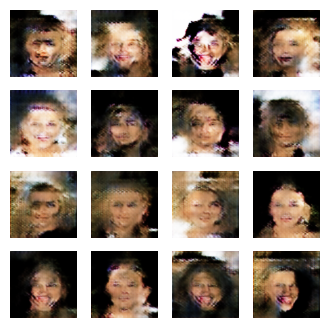

2025-03-22 18:47:49.491643: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 51/100: 100%|█████████████████████████████| 79/79 [04:50<00:00,  3.68s/it]


Generator Loss: 5.5209 | Discriminator Loss: 0.1288 | Time: 290.54 sec


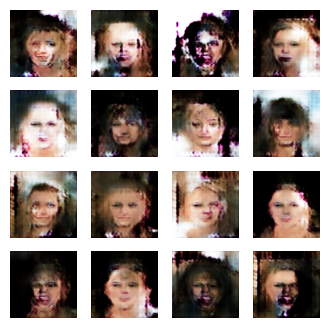

2025-03-22 18:52:39.472427: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 52/100: 100%|█████████████████████████████| 79/79 [04:49<00:00,  3.67s/it]


Generator Loss: 5.9858 | Discriminator Loss: 0.1318 | Time: 289.69 sec


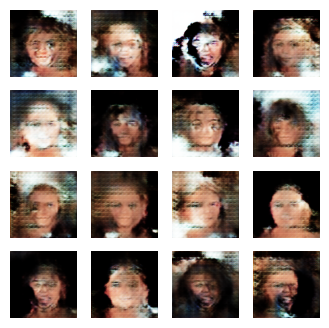

2025-03-22 18:57:34.278531: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 53/100: 100%|█████████████████████████████| 79/79 [04:54<00:00,  3.73s/it]

Generator Loss: 9.0940 | Discriminator Loss: 0.1603 | Time: 294.51 sec


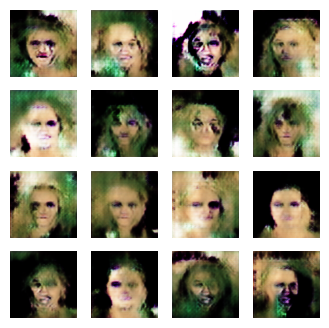

2025-03-22 19:02:28.176764: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 54/100: 100%|█████████████████████████████| 79/79 [04:53<00:00,  3.72s/it]

Generator Loss: 7.4342 | Discriminator Loss: 0.1623 | Time: 293.62 sec


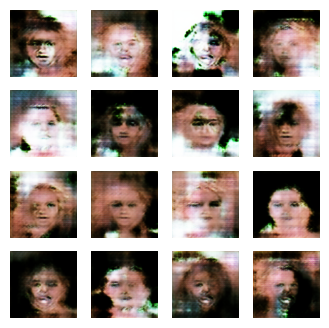

2025-03-22 19:07:27.253839: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 55/100: 100%|█████████████████████████████| 79/79 [04:58<00:00,  3.78s/it]


Generator Loss: 5.4055 | Discriminator Loss: 0.1038 | Time: 298.82 sec


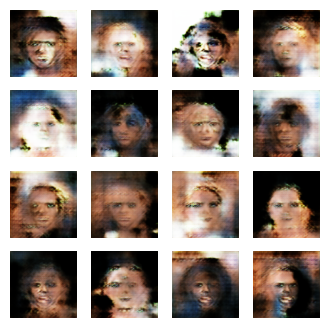

2025-03-22 19:12:21.769762: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 56/100: 100%|█████████████████████████████| 79/79 [04:54<00:00,  3.72s/it]

Generator Loss: 6.2096 | Discriminator Loss: 0.0963 | Time: 294.23 sec


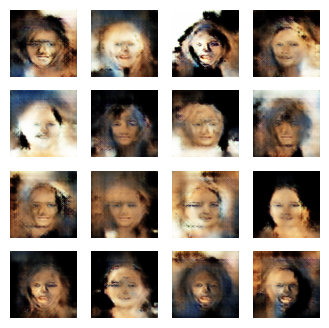

2025-03-22 19:17:04.669364: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 57/100: 100%|█████████████████████████████| 79/79 [04:42<00:00,  3.58s/it]


Generator Loss: 5.6162 | Discriminator Loss: 0.1268 | Time: 282.63 sec


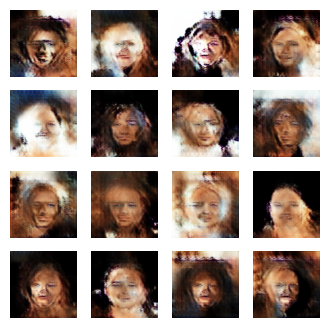

2025-03-22 19:21:50.486811: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 58/100: 100%|█████████████████████████████| 79/79 [04:45<00:00,  3.61s/it]

Generator Loss: 5.2562 | Discriminator Loss: 0.1095 | Time: 285.46 sec


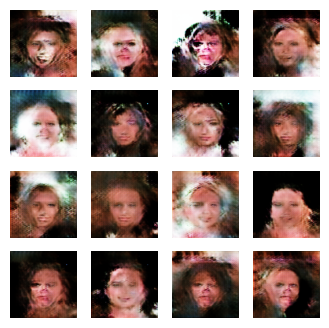

2025-03-22 19:26:38.293639: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 59/100: 100%|█████████████████████████████| 79/79 [04:47<00:00,  3.64s/it]

Generator Loss: 5.8461 | Discriminator Loss: 0.1210 | Time: 287.54 sec


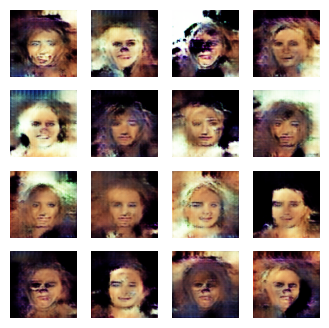

2025-03-22 19:31:19.741408: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 60/100: 100%|█████████████████████████████| 79/79 [04:41<00:00,  3.56s/it]

Generator Loss: 5.9169 | Discriminator Loss: 0.1118 | Time: 281.18 sec


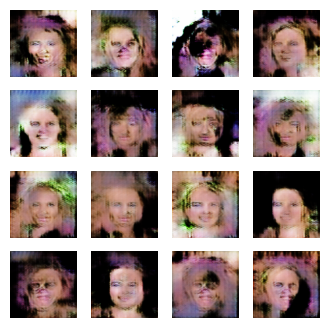

2025-03-22 19:36:14.479929: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 61/100: 100%|█████████████████████████████| 79/79 [04:54<00:00,  3.73s/it]

Generator Loss: 5.4699 | Discriminator Loss: 0.1144 | Time: 294.48 sec


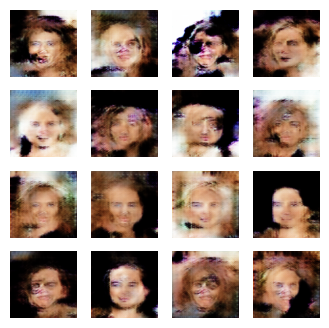

2025-03-22 19:41:06.723207: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 62/100: 100%|█████████████████████████████| 79/79 [04:51<00:00,  3.70s/it]


Generator Loss: 5.0832 | Discriminator Loss: 0.1113 | Time: 291.99 sec


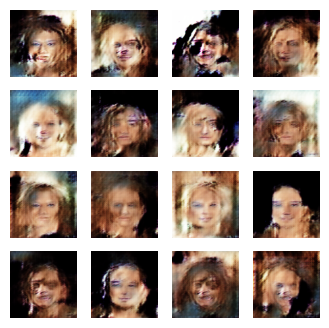

2025-03-22 19:45:55.671607: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 63/100: 100%|█████████████████████████████| 79/79 [04:48<00:00,  3.65s/it]

Generator Loss: 5.3861 | Discriminator Loss: 0.1376 | Time: 288.66 sec


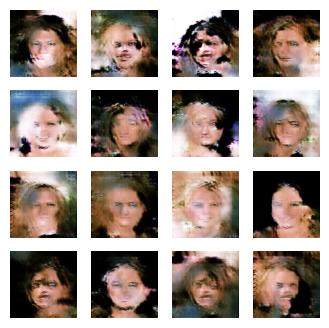

2025-03-22 19:50:27.397657: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 64/100: 100%|█████████████████████████████| 79/79 [04:31<00:00,  3.44s/it]


Generator Loss: 5.3771 | Discriminator Loss: 0.1469 | Time: 271.49 sec


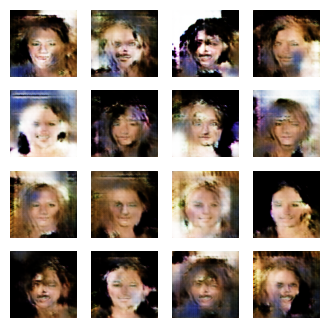

2025-03-22 19:54:40.351592: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 65/100: 100%|█████████████████████████████| 79/79 [04:12<00:00,  3.20s/it]

Generator Loss: 5.4653 | Discriminator Loss: 0.1127 | Time: 252.63 sec


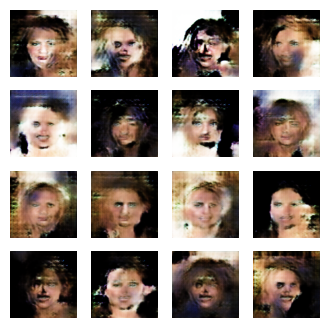

2025-03-22 19:59:09.330875: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 66/100: 100%|█████████████████████████████| 79/79 [04:28<00:00,  3.40s/it]


Generator Loss: 5.5828 | Discriminator Loss: 0.1427 | Time: 268.72 sec


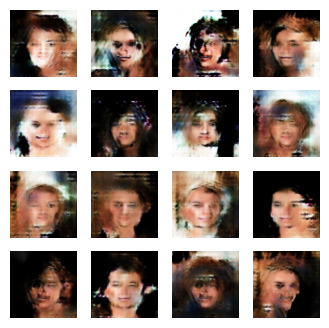

2025-03-22 20:04:20.748528: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 67/100: 100%|█████████████████████████████| 79/79 [05:11<00:00,  3.94s/it]


Generator Loss: 5.5524 | Discriminator Loss: 0.1239 | Time: 311.12 sec


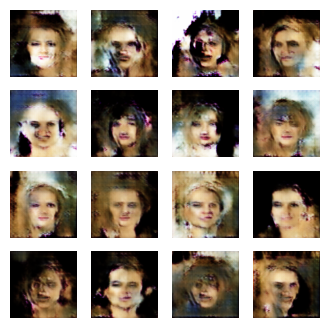

2025-03-22 20:09:42.348116: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 68/100: 100%|█████████████████████████████| 79/79 [05:20<00:00,  4.06s/it]

Generator Loss: 5.9824 | Discriminator Loss: 0.1592 | Time: 321.01 sec


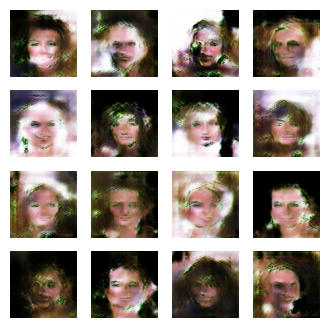

2025-03-22 20:14:44.749673: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 69/100: 100%|█████████████████████████████| 79/79 [05:02<00:00,  3.82s/it]

Generator Loss: 5.4131 | Discriminator Loss: 0.1303 | Time: 302.15 sec


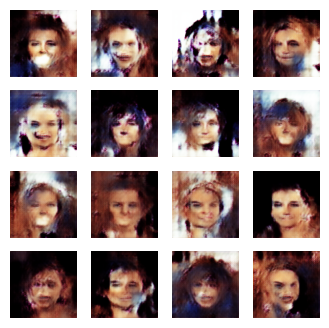

2025-03-22 20:19:23.121632: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 70/100: 100%|█████████████████████████████| 79/79 [04:38<00:00,  3.52s/it]

Generator Loss: 5.4206 | Discriminator Loss: 0.1367 | Time: 278.13 sec


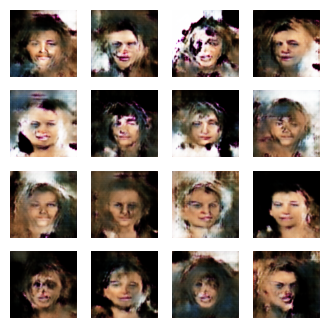

2025-03-22 20:24:19.448084: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 71/100: 100%|█████████████████████████████| 79/79 [04:56<00:00,  3.75s/it]


Generator Loss: 5.5130 | Discriminator Loss: 0.1356 | Time: 296.06 sec


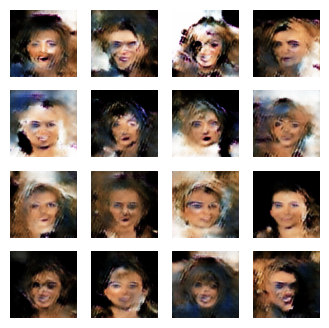

2025-03-22 20:28:48.688577: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 72/100: 100%|█████████████████████████████| 79/79 [04:28<00:00,  3.40s/it]

Generator Loss: 5.4805 | Discriminator Loss: 0.1052 | Time: 268.86 sec


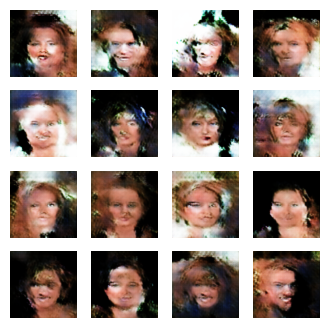

2025-03-22 20:33:32.319029: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 73/100: 100%|█████████████████████████████| 79/79 [04:43<00:00,  3.59s/it]

Generator Loss: 5.1459 | Discriminator Loss: 0.1116 | Time: 283.40 sec


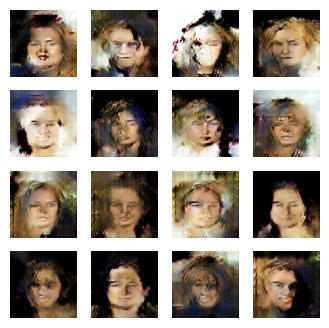

2025-03-22 20:38:08.267724: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 74/100: 100%|█████████████████████████████| 79/79 [04:35<00:00,  3.49s/it]


Generator Loss: 5.6203 | Discriminator Loss: 0.1407 | Time: 275.68 sec


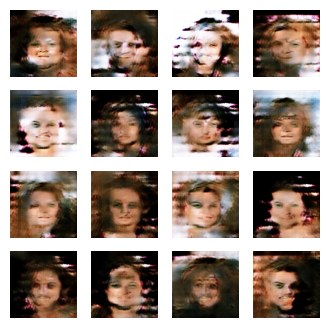

2025-03-22 20:42:26.328383: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 75/100: 100%|█████████████████████████████| 79/79 [04:17<00:00,  3.26s/it]

Generator Loss: 6.7416 | Discriminator Loss: 0.2300 | Time: 257.70 sec


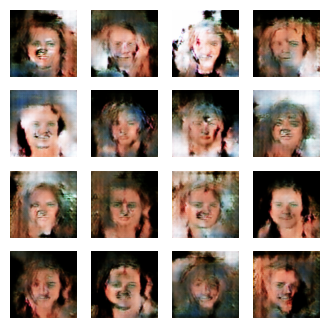

2025-03-22 20:46:31.629716: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 76/100: 100%|█████████████████████████████| 79/79 [04:05<00:00,  3.10s/it]

Generator Loss: 5.3693 | Discriminator Loss: 0.1792 | Time: 245.08 sec


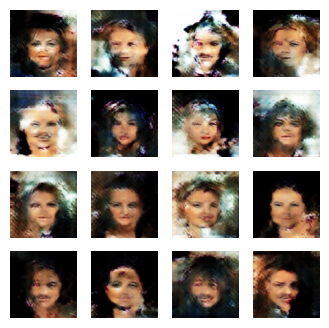

2025-03-22 20:50:58.033649: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 77/100: 100%|█████████████████████████████| 79/79 [04:26<00:00,  3.37s/it]

Generator Loss: 4.8510 | Discriminator Loss: 0.1276 | Time: 266.15 sec


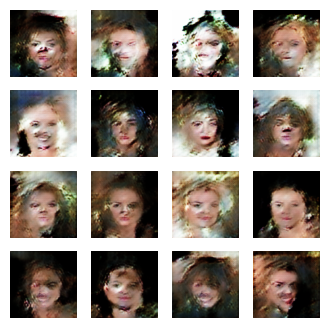

2025-03-22 20:55:30.178542: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 78/100: 100%|█████████████████████████████| 79/79 [04:31<00:00,  3.44s/it]


Generator Loss: 5.7023 | Discriminator Loss: 0.1150 | Time: 271.89 sec


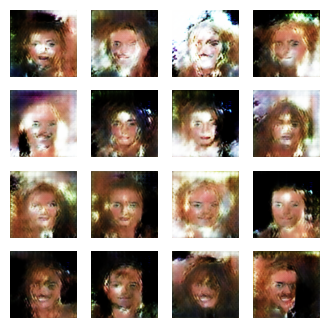

2025-03-22 20:59:43.154734: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 79/100: 100%|█████████████████████████████| 79/79 [04:12<00:00,  3.20s/it]

Generator Loss: 5.1310 | Discriminator Loss: 0.1251 | Time: 252.64 sec


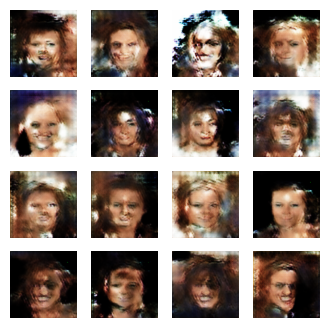

2025-03-22 21:04:16.552484: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 80/100: 100%|█████████████████████████████| 79/79 [04:33<00:00,  3.46s/it]

Generator Loss: 4.8792 | Discriminator Loss: 0.1522 | Time: 273.14 sec


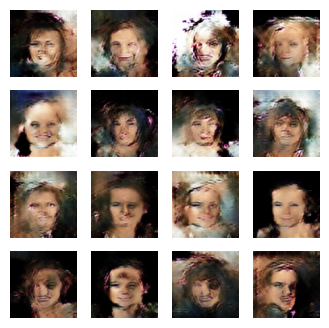

2025-03-22 21:08:56.972946: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 81/100: 100%|█████████████████████████████| 79/79 [04:40<00:00,  3.55s/it]

Generator Loss: 5.1258 | Discriminator Loss: 0.1198 | Time: 280.15 sec


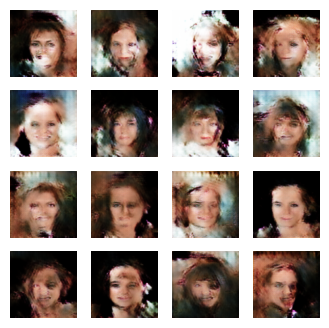

2025-03-22 21:13:23.362435: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 82/100: 100%|█████████████████████████████| 79/79 [04:26<00:00,  3.37s/it]

Generator Loss: 4.9235 | Discriminator Loss: 0.2088 | Time: 266.15 sec


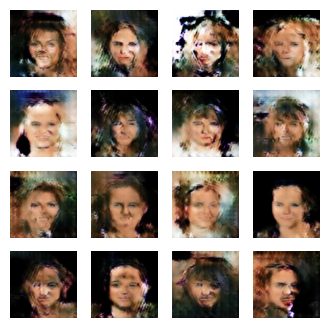

2025-03-22 21:17:55.764195: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 83/100: 100%|█████████████████████████████| 79/79 [04:32<00:00,  3.44s/it]

Generator Loss: 5.1566 | Discriminator Loss: 0.1182 | Time: 272.16 sec


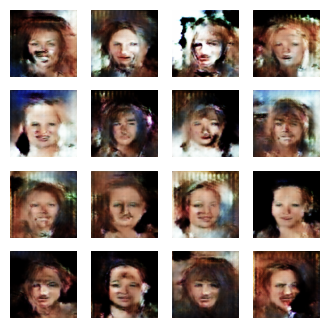

2025-03-22 21:22:35.721351: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 84/100: 100%|█████████████████████████████| 79/79 [04:39<00:00,  3.54s/it]

Generator Loss: 5.4661 | Discriminator Loss: 0.1277 | Time: 279.71 sec


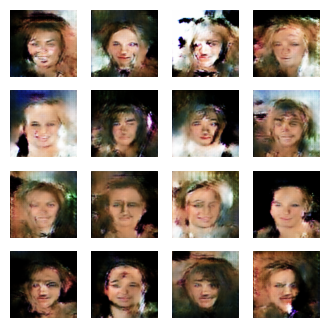

2025-03-22 21:27:17.209908: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 85/100: 100%|█████████████████████████████| 79/79 [04:41<00:00,  3.56s/it]


Generator Loss: 5.0808 | Discriminator Loss: 0.1462 | Time: 281.24 sec


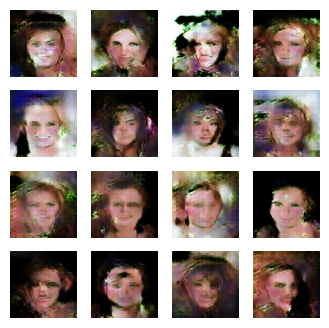

2025-03-22 21:32:00.363523: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 86/100: 100%|█████████████████████████████| 79/79 [04:42<00:00,  3.58s/it]

Generator Loss: 5.1547 | Discriminator Loss: 0.1437 | Time: 282.77 sec


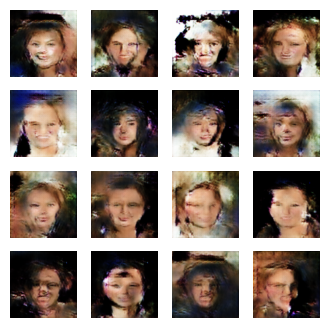

2025-03-22 21:36:43.112710: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 87/100: 100%|█████████████████████████████| 79/79 [04:42<00:00,  3.58s/it]

Generator Loss: 5.0286 | Discriminator Loss: 0.1341 | Time: 282.49 sec


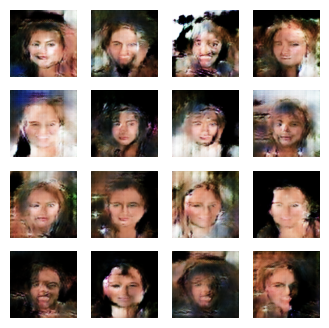

2025-03-22 21:41:30.153731: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 88/100: 100%|█████████████████████████████| 79/79 [04:46<00:00,  3.63s/it]

Generator Loss: 4.9276 | Discriminator Loss: 0.1427 | Time: 286.78 sec


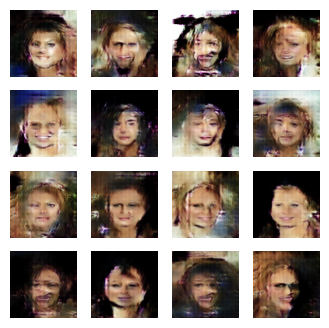

2025-03-22 21:46:04.881879: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 89/100: 100%|█████████████████████████████| 79/79 [04:34<00:00,  3.47s/it]

Generator Loss: 5.1855 | Discriminator Loss: 0.1160 | Time: 274.47 sec


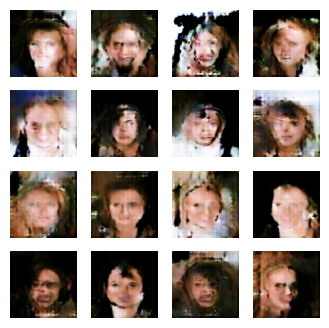

2025-03-22 21:50:47.090727: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 90/100: 100%|█████████████████████████████| 79/79 [04:41<00:00,  3.57s/it]

Generator Loss: 5.1376 | Discriminator Loss: 0.1230 | Time: 281.97 sec


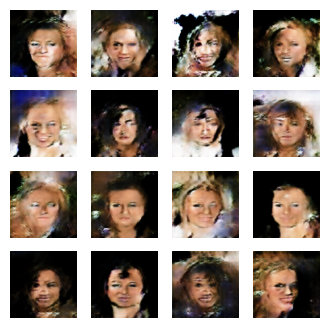

2025-03-22 21:55:40.349063: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 91/100: 100%|█████████████████████████████| 79/79 [04:52<00:00,  3.71s/it]


Generator Loss: 5.3387 | Discriminator Loss: 0.1419 | Time: 292.98 sec


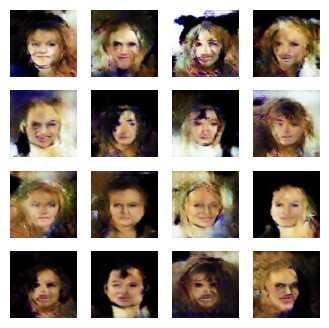

2025-03-22 22:00:35.629949: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 92/100: 100%|█████████████████████████████| 79/79 [04:54<00:00,  3.73s/it]


Generator Loss: 5.3697 | Discriminator Loss: 0.1437 | Time: 294.99 sec


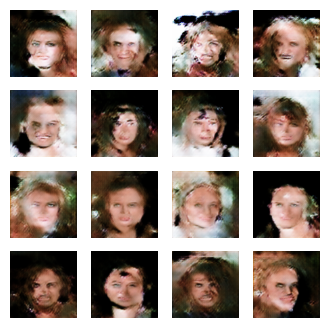

2025-03-22 22:05:35.316575: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 93/100: 100%|█████████████████████████████| 79/79 [04:59<00:00,  3.79s/it]

Generator Loss: 5.5107 | Discriminator Loss: 0.1258 | Time: 299.29 sec


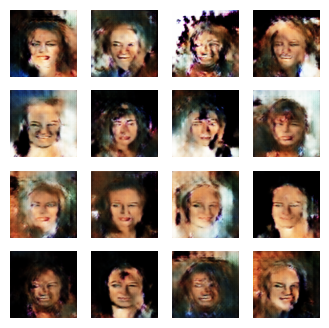

2025-03-22 22:10:33.730533: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 94/100: 100%|█████████████████████████████| 79/79 [04:58<00:00,  3.77s/it]


Generator Loss: 5.6418 | Discriminator Loss: 0.1423 | Time: 298.13 sec


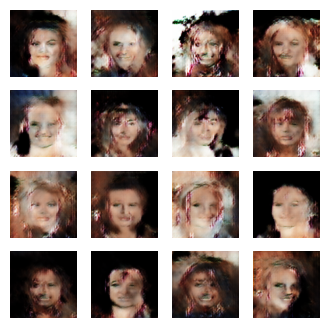

2025-03-22 22:15:30.636632: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 95/100: 100%|█████████████████████████████| 79/79 [04:56<00:00,  3.75s/it]


Generator Loss: 6.0647 | Discriminator Loss: 0.1796 | Time: 296.61 sec


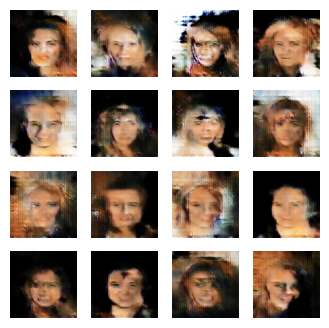

2025-03-22 22:20:11.319356: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 96/100: 100%|█████████████████████████████| 79/79 [04:40<00:00,  3.55s/it]

Generator Loss: 6.5966 | Discriminator Loss: 0.1530 | Time: 280.27 sec


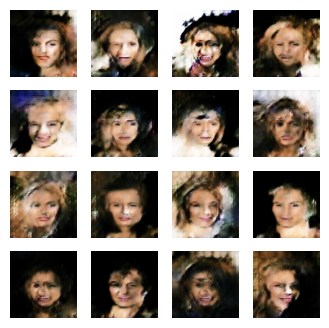

2025-03-22 22:24:56.761503: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 97/100: 100%|█████████████████████████████| 79/79 [04:45<00:00,  3.61s/it]


Generator Loss: 5.9029 | Discriminator Loss: 0.1788 | Time: 285.19 sec


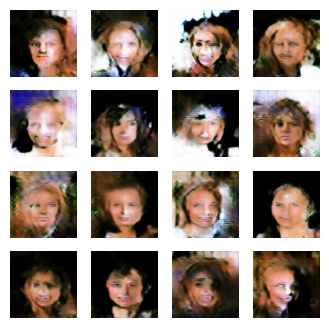

2025-03-22 22:29:55.727379: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 98/100: 100%|█████████████████████████████| 79/79 [04:58<00:00,  3.78s/it]


Generator Loss: 4.8641 | Discriminator Loss: 0.1383 | Time: 298.49 sec


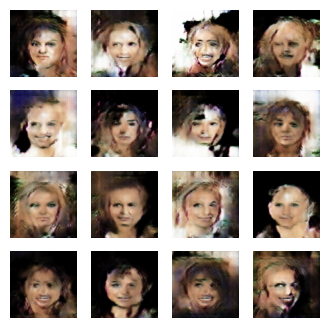

2025-03-22 22:34:15.065363: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 99/100: 100%|█████████████████████████████| 79/79 [04:18<00:00,  3.28s/it]


Generator Loss: 5.3293 | Discriminator Loss: 0.1372 | Time: 258.97 sec


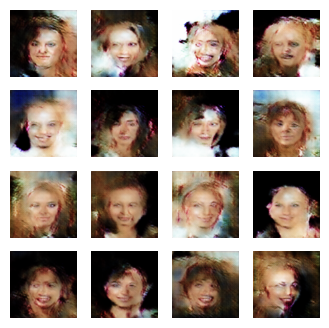

2025-03-22 22:38:13.602294: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence
Epoch 100/100: 100%|████████████████████████████| 79/79 [03:58<00:00,  3.01s/it]

Generator Loss: 5.3357 | Discriminator Loss: 0.1393 | Time: 238.20 sec


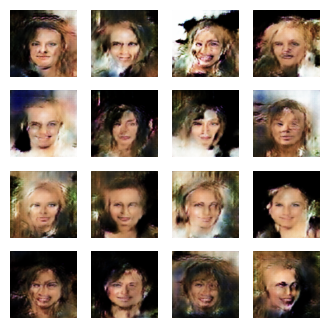


🎉 Total Training Time: 28435.60 sec


In [10]:
train(dataset, 100)

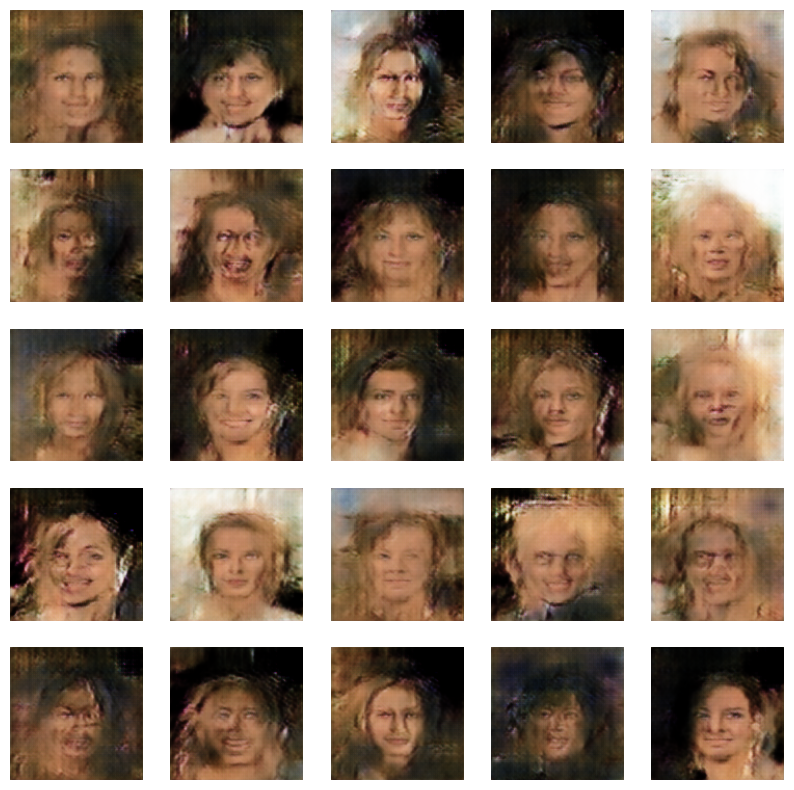

In [11]:
plot_generated_images(5)